<a href="https://colab.research.google.com/github/christianbv/AgeNet/blob/main/Notebooks/0_Preprocessing_IMDB_images.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0. Imports

In [ ]:
#@markdown <b>Run me to import underscore module</b><br/>   {display-mode: "form"}
#@markdown <small>Method signatures:</small><br/> 
#@markdown <small><small>&nbsp; &nbsp; &nbsp; __(source_path, target_path, copy=True, auth_on_upload=True)</small></small><br/>
#@markdown <small><small>&nbsp; &nbsp; &nbsp; _set_gh_token(token)</small></small><br/>
#@markdown <small><small>&nbsp; &nbsp; &nbsp; _from_gh(user_name, repo_name, release_name) &nbsp; &nbsp; &nbsp; <b>Returns:</B> dictionary of arrays { 'array_name' : np.ndarray }</small></small><br/>
#@markdown <small><small>&nbsp; &nbsp; &nbsp; _to_gh(user_name, repo_name, release_name, split_size=600, **arr_kwargs)</small></small><br/>


!pip install -q githubrelease
import numpy as np
import os, glob, re, time
import github_release

compressed_dirs = set()


def _compress(source_path, target_path, target_dir=None):
    if target_dir:
        !mkdir -p {target_dir}
    if target_path.endswith('.tar.gz'):
        !tar -czf {target_path} -C {source_path} .
    elif target_path.endswith('.tar'):
        !tar -cf {target_path} -C {source_path} .
    elif target_path.endswith('.zip'):
        !(cd {source_path} && zip -q -r {target_path} .)


def _extract(source_path, target_path):
    !mkdir -p {target_path}
    if source_path.endswith('.tar.gz'):
        !tar -xzf {source_path} -C {target_path}
    elif source_path.endswith('.tar'):
        !tar -xf {source_path} -C {target_path}
    elif source_path.endswith('.zip'):
        !unzip -qq {source_path} -d {target_path}


def __(source_path, target_path, copy=True, auth_on_upload=True):
    """
    Use cases:
        Movement:
            - GCS -> GCS
            - GCS -> LOCAL
            - LOCAL -> GCS
            - LOCAL -> LOCAL
            
        Compression (e.g. from dir to .tar.gz):
            - GCS -> GCS
            - GCS -> LOCAL
            - LOCAL -> GCS
            - LOCAL -> LOCAL
            
        Extraction (e.g. from .zip to dir):
            - GCS -> GCS
            - GCS -> LOCAL
            - LOCAL -> GCS
            - LOCAL -> LOCAL
            
        Extraction & compression (e.g. from .zip to .tar.gz):
            - GCS -> GCS
            - GCS -> LOCAL
            - LOCAL -> GCS
            - LOCAL -> LOCAL
    """
    COMPRESSION_FORMATS = ('zip', 'tar', 'tar.gz')
    TEMP_DIR = "/tmp_"
    LOG_TEMPLATE = "{}    from    {}    to    {}"

    # Source
    if source_path.endswith("/"):
        source_path = source_path[:-1]
    source_dir, _, source_name = source_path.rpartition('/')
    source_isgcs = source_path.startswith("gs://")
    source_islocal = not source_isgcs
    if source_islocal:
        source_path = os.path.abspath(source_path)
    source_isprefix, source_isfile, source_ext = source_name.partition('.')
    source_isdir = not source_isfile
    source_iscompression = source_ext in COMPRESSION_FORMATS

    # Target
    target_dir, _, target_name = target_path.rpartition('/')
    target_isgcs = target_path.startswith("gs://")
    target_islocal = not target_isgcs
    target_prefix, target_isfile, target_ext = target_name.partition('.')
    target_isdir = not target_isfile
    target_iscompression = target_ext in COMPRESSION_FORMATS

    # Flags
    MOVE_ONLY = source_ext == target_ext
    GCS_ONLY = source_isgcs and target_isgcs
    RENAME = source_isprefix != target_prefix
    COMPRESSION = source_isdir and target_iscompression
    EXTRACTION = source_iscompression and target_isdir
    EXTRACTION_COMPRESSION = source_iscompression and target_iscompression and source_ext != target_ext

    # Add forward slash if file is at root level
    source_dir = "/" if not source_dir else source_dir
    target_dir = "/" if not target_dir else target_dir

    # Authenticate if writing to GCS
    if target_isgcs and auth_on_upload:
        from google.colab import auth
        auth.authenticate_user()

    # Assert that subdirectories exist if target is local
    if target_islocal:
        !mkdir -p {target_dir}

    # Movement commands
    if MOVE_ONLY:
        # GCS -> GCS
        if source_isgcs and target_isgcs:
            action = "COPYING" if copy else "MOVING"
            print(LOG_TEMPLATE.format(f"{action} (1/1)", source_path, target_path))
            if copy:
                !gsutil -m -q cp -r {source_path} {target_path}
            else:
                !gsutil -m -q mv {source_path} {target_path}
        
        # LOCAL -> LOCAL
        elif source_islocal and target_islocal:
            action = "COPYING" if copy else "MOVING"
            print(LOG_TEMPLATE.format(f"{action} (1/1)", source_path, target_path))
            if copy:
                !cp -r {source_path} {target_path}
            else:
                !mv {source_path} {target_path}
        
        # GCS -> LOCAL
        elif source_isgcs and target_islocal:
            if source_isdir:
                print(LOG_TEMPLATE.format("DOWNLOADING DIR (1/1)", source_path, target_dir))
                !gsutil -m -q cp -r {source_path} {target_dir}
                if RENAME:
                    print(LOG_TEMPLATE.format("\tRENAMING DIR", source_isprefix, target_prefix))
                    !mv {target_dir}/{source_isprefix} {target_dir}/{target_prefix}
            else:
                print(LOG_TEMPLATE.format("DOWNLOADING FILE (1/1)", source_path, target_path))
                !gsutil -m -q cp {source_path} {target_path}
        
        # LOCAL -> GCS
        if source_islocal and target_isgcs:
            if source_isdir:
                print(LOG_TEMPLATE.format("UPLOADING DIR (1/1)", source_path, target_path))
                !gsutil -m -q cp -r {source_path} {target_path}
            else:
                print(LOG_TEMPLATE.format("UPLOADING FILE (1/1)", source_path, target_path))
                !gsutil -m -q cp {source_path} {target_path}
        return


    # Create directory for intermediate storage if required
    if source_isgcs or target_isgcs or EXTRACTION_COMPRESSION:
        !mkdir -p {TEMP_DIR}
    

    # For remaining operations, download GCS source to temp and treat as local
    if source_isgcs:
        if source_isdir:
            print(LOG_TEMPLATE.format("\tDOWNLOADING DIR", source_path, TEMP_DIR))
            !gsutil -m -q cp -r {source_path} {TEMP_DIR}
        else:
            print(LOG_TEMPLATE.format("\tDOWNLOADING FILE", source_path, f"{TEMP_DIR}/{source_name}"))
            !gsutil -m -q cp {source_path} {TEMP_DIR}/{source_name}
        source_path = f"{TEMP_DIR}/{source_name}"
        source_dir = TEMP_DIR

    # Compression
    if COMPRESSION:
        if target_islocal:
            print(LOG_TEMPLATE.format("COMPRESSING (1/1)", source_path, target_path))
            _compress(source_path, target_path, target_dir=target_dir)
        else:
            print(LOG_TEMPLATE.format("COMPRESSING (1/2)", source_path, f"{TEMP_DIR}/{target_name}"))
            _compress(source_path, f"{TEMP_DIR}/{target_name}")
            print(LOG_TEMPLATE.format("UPLOADING FILE (2/2)", f"{TEMP_DIR}/{target_name}", target_path))
            !gsutil -m -q cp {TEMP_DIR}/{target_name} {target_path}

    # Extraction
    elif EXTRACTION:
        if target_islocal:
            print(LOG_TEMPLATE.format("EXTRACTING (1/1)", source_path, target_path))
            _extract(source_path, target_path)
        else:
            print(LOG_TEMPLATE.format("EXTRACTING (1/2)", source_path, f"{TEMP_DIR}/{target_name}"))
            _extract(source_path, f"{TEMP_DIR}/{target_name}")
            print(LOG_TEMPLATE.format("UPLOADING DIR (2/2)", f"{TEMP_DIR}/{target_name}", target_path))
            !gsutil -m -q cp -r {TEMP_DIR}/{target_name} {target_path}

    # Extraction & compression
    elif EXTRACTION_COMPRESSION:
        if target_islocal:
            print(LOG_TEMPLATE.format("EXTRACTING (1/2)", source_path, f"{TEMP_DIR}/{target_prefix}"))
            _extract(source_path, f"{TEMP_DIR}/{target_prefix}")
            print(LOG_TEMPLATE.format("COMPRESSING (2/2)", f"{TEMP_DIR}/{target_prefix}", target_path))
            _compress(f"{TEMP_DIR}/{target_prefix}", target_path, target_dir=target_dir)
        else:
            print(LOG_TEMPLATE.format("EXTRACTING (1/3)", source_path, f"{TEMP_DIR}/{target_prefix}"))
            _extract(source_path, f"{TEMP_DIR}/{target_prefix}")
            print(LOG_TEMPLATE.format("COMPRESSING (2/3)", f"{TEMP_DIR}/{target_prefix}", f"{TEMP_DIR}/{target_name}"))
            _compress(f"{TEMP_DIR}/{target_prefix}", f"{TEMP_DIR}/{target_name}")
            print(LOG_TEMPLATE.format("UPLOADING FILE (3/3)", f"{TEMP_DIR}/{target_name}", target_path))
            !gsutil -m -q cp {TEMP_DIR}/{target_name} {target_path}
    
    # Cleanup intermediate storage
    !rm -rf {TEMP_DIR}


def _set_gh_token(token):
    os.environ["GITHUB_TOKEN"] = token


def _export_array(array, release_name, prefix="", splits=3):
    dir_path = f"/tmp_/{release_name}"
    !mkdir -p {dir_path}
    n_digits = len(str(splits - 1))
    subarrays = np.array_split(array, splits)
    for i, subarray in enumerate(subarrays):
        filename = f"{prefix}__{str(i).zfill(n_digits)}.npy"
        np.save(f"{dir_path}/{filename}", subarray)


def _concat_arrays(paths):
    return np.concatenate([np.load(path, allow_pickle=True) for path in sorted(paths)])


def _to_gh(user_name, repo_name, release_name, split_size=600, **arr_kwargs):
    # Assert that GitHub Auth token is set
    if "GITHUB_TOKEN" not in os.environ:
        print("GitHub authentication token is not set.")
        print("Set token using the '_set_gh_token(token_string)' method.")
        print("Minimal required auth scope is 'repo/public_repo' for public repositories.")
        print("URL: https://github.com/settings/tokens/new")
        return

    # Split arrays
    for prefix, array in arr_kwargs.items():
        splits = int((array.nbytes/1_000_000) // split_size) + 1
        _export_array(array, release_name, prefix=prefix, splits=splits)

    # Upload arrays
    github_release.gh_release_create(
        f"{user_name}/{repo_name}", 
        release_name, 
        publish=True, 
        name=release_name, 
        asset_pattern=f"/tmp_/{release_name}/*"
    )
    !rm -rf /tmp_/*


def _from_gh(user_name, repo_name, release_name):
    # Download release to temporary directory
    print("Downloading dataset in parallell ... ", end='\t')
    t0 = time.perf_counter()
    assets = github_release.get_assets(f"{user_name}/{repo_name}", tag_name=release_name)
    download_urls = [asset['browser_download_url'] for asset in assets]
    urls_str = " ".join(download_urls)
    !echo {urls_str} | xargs -n 1 -P 8 wget -q -P /tmp_/{release_name}_dl/
    t1 = time.perf_counter()
    print(f"done! ({t1 - t0:.3f} seconds)")

    # Load data into numpy arrays
    paths = glob.glob(f"/tmp_/{release_name}_dl/*.npy")
    groups = {}
    for path in paths:
        match = re.match(r".*/(.*)__[0-9]*\.npy", path)
        if match:
            prefix = match.group(1)
            groups[prefix] = groups.get(prefix, []) + [path]
    arrays_dict = {name: _concat_arrays(paths) for name, paths in groups.items()}
    !rm -rf /tmp_/*
    return arrays_dict
    

def _log_to_gh(user, repo, tag, log_dir="/tmp/logs"):
    # Create temporary directory for compressed logs
    !mkdir -p /tmp/compressed_logs
    
    # Compress all directories in log dir
    for dirname in os.listdir(log_dir):
        # Skip files
        if "." in dirname or dirname in compressed_dirs:
            continue

        # Compress
        __(f"{log_dir}/{dirname}", f"/tmp/compressed_logs/{dirname}.tar.gz")
        compressed_dirs.add(dirname)

    # Upload compressed logs to GitHub
    github_release.gh_asset_upload(f"{user}/{repo}", tag, f"/tmp/compressed_logs/*.tar.gz")

    # Cleanup compressed logs
    !rm -rf /tmp/compressed_logs/*

In [ ]:
!pip install dlib
!pip install face_recognition

     |████████████████████████████████| 100.2MB 104kB/s 
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566173 sha256=f42ac594e8b25238f7119b594fefe849e7a09e9f94937df38725fa6074d61460
  Stored in directory: /root/.cache/pip/wheels/d2/99/18/59c6c8f01e39810415c0e63f5bede7d83dfb0ffc039865465f
Successfully built face-recognition-models


In [ ]:
from google.colab import auth
from google.colab import drive
import os
from os import walk 
from os import listdir
from os.path import isfile, join
from IPython.display import display
from PIL import Image, ImageDraw
import numpy as np
import glob
import shutil
import face_recognition

In [ ]:
# Authenticate towards google cloud platform to be able to read and write 
auth.authenticate_user()
print('Authenticated')
drive.mount('/content/drive') 

Authenticated
Mounted at /content/drive


# 1. Create methods

In [ ]:
def plot_sample_images(n, filepath):
  count = 0 
  satisfied = n
  for (dirpath, dirnames, filenames) in walk (filepath):
    for f in filenames:
      if f.endswith(".jpg"):
        im = Image.open(dirpath + "/" + f)
        display(im)
        count += 1

      if(count >= satisfied):
        return
    if(count>= satisfied):
      return

def get_bin_age(buckets, age):
  for i in range(len(buckets)):
    if age < buckets[i]:
      return f"{buckets[i-1]}-{buckets[i]-1}"

  return "undf"


def get_resized_image(file_path, height, width):
    im = Image.open(file_path)
    print(im.size)
    im_resize = im.resize((128,128), Image.ANTIALIAS)
    print(im_resize.size)
    return im_resize

def get_age_IMDB(filename):
  info = filename.split("_")
  if (len(info)< 3):
    return -1
  born = info[-2][0:4]
  picture_taken = info[-1][:-4]
  
  if not born.isdigit() or not picture_taken.isdigit():
    return -1
  age = int(picture_taken) - int(born)
  if(age < 0 or age >110):
    return -1
  return age


  def save_image(file_path, file_name, im):
  folder_path = file_path + "/" 
  if not os.path.exists(folder_path):
    os.makedirs(folder_path)
  else: 
   im.save(folder_path + "/" + file_name)

  
def backup_to_bucket(colab_folder, bucket_folder):
  id = np.random.randint(1,10000)
  num =   len(glob.glob(colab_folder + "/*.jpg", recursive=True))

  __(colab_folder, bucket_folder + "-num_pic-" + str(num) +"-id-" + str(id) + ".zip", auth_on_upload=False)
  print(f"Successfully backed up {num} pictures")


# 2. Make sure that the filepath matches the path where you saved the images

In [ ]:
# Extract the data from local drive
# TODO: You will need to change the address to match the local address where you stored the downloarded IMDB dataset 
shutil.unpack_archive('/content/drive/My Drive/7.Semester/TDT4173 Maskinlæring/Datasets/imdb_crop.tar','/content/IMDB')

# 3. Preprocess IMDB dataset

COMPRESSING (1/2)    from    /content/IMDB_2/batch-1    to    /tmp_/batch-1-num_pic-0-id-1256.zip
/bin/bash: line 0: cd: /content/IMDB_2/batch-1: No such file or directory
UPLOADING FILE (2/2)    from    /tmp_/batch-1-num_pic-0-id-1256.zip    to    gs://ntnu-ml-bucket/IMDB/batches/batch-1-num_pic-0-id-1256.zip
CommandException: No URLs matched: /tmp_/batch-1-num_pic-0-id-1256.zip
CommandException: 1 file/object could not be transferred.
Successfully backed up 0 pictures
Saved saved new images


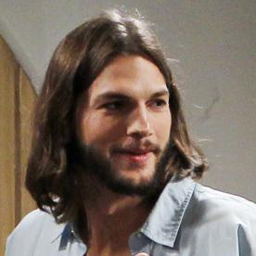

Saved saved new images


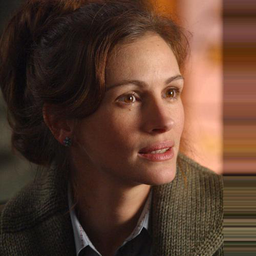

Processed 500
Saved saved new images


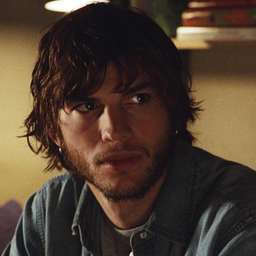

Saved saved new images


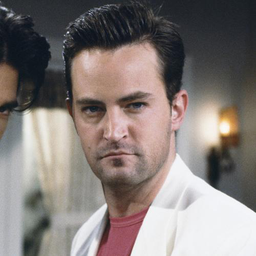

Processed 1000
Saved saved new images


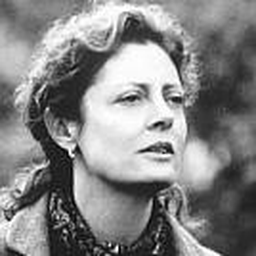

Saved saved new images


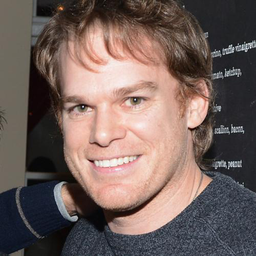

Saved saved new images


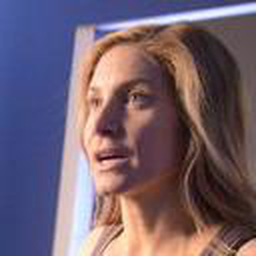

Processed 1500
Saved saved new images


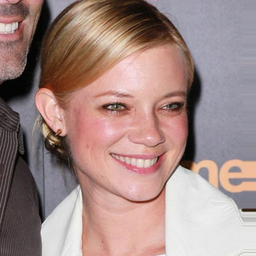

Saved saved new images


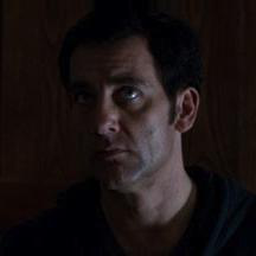

Processed 2000
Saved saved new images


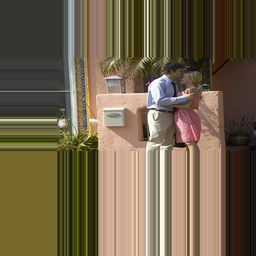

Saved saved new images


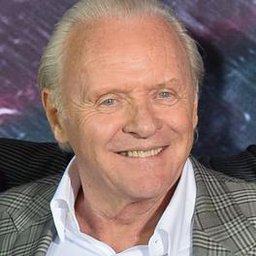

Saved saved new images


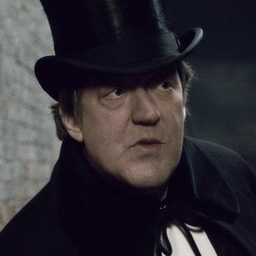

Processed 2500
Saved saved new images


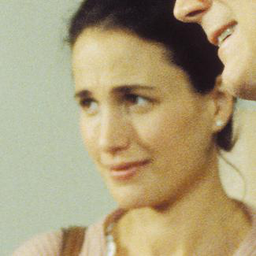

Saved saved new images


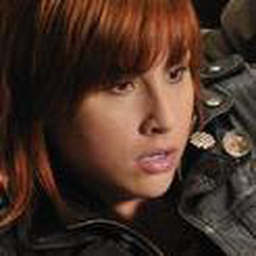

Processed 3000
Saved saved new images


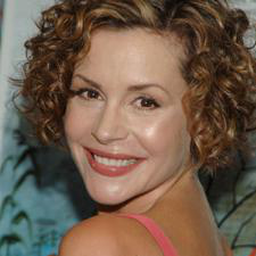

Saved saved new images


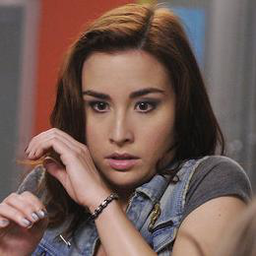

Saved saved new images


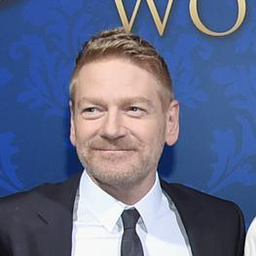

Processed 3500
Saved saved new images


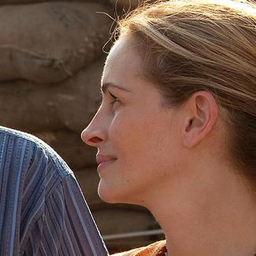

Saved saved new images


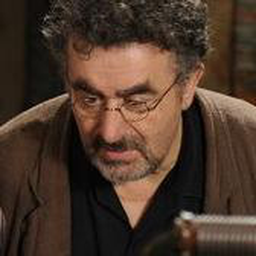

Processed 4000
Saved saved new images


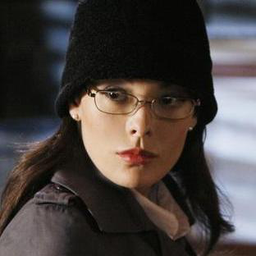

Saved saved new images


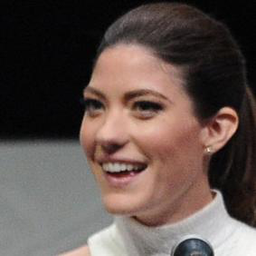

Saved saved new images


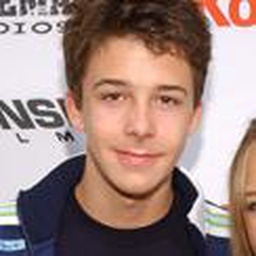

Processed 4500
Saved saved new images


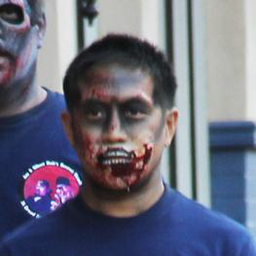

Saved saved new images


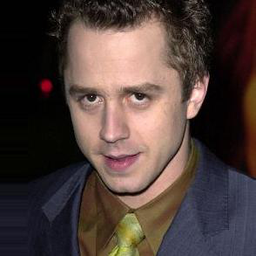

Processed 5000
Saved saved new images


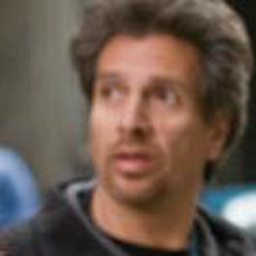

Saved saved new images


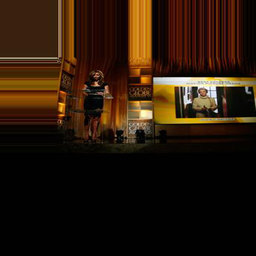

COMPRESSING (1/2)    from    /content/IMDB_2/batch-2    to    /tmp_/batch-2-num_pic-5392-id-7413.zip
UPLOADING FILE (2/2)    from    /tmp_/batch-2-num_pic-5392-id-7413.zip    to    gs://ntnu-ml-bucket/IMDB/batches/batch-2-num_pic-5392-id-7413.zip
Successfully backed up 5392 pictures
Saved saved new images


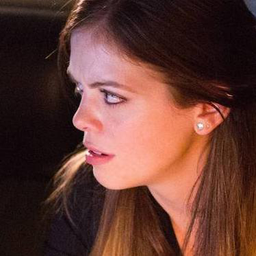

Processed 5500
Saved saved new images


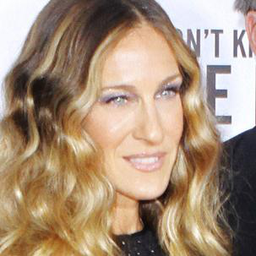

Saved saved new images


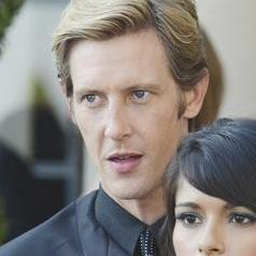

Processed 6000
Saved saved new images


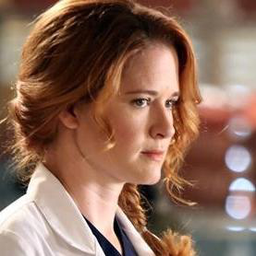

Saved saved new images


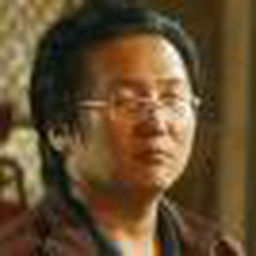

Saved saved new images


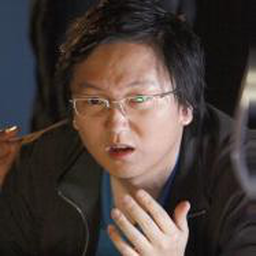

Processed 6500
Saved saved new images


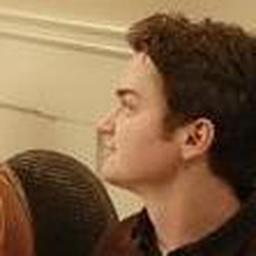

Saved saved new images


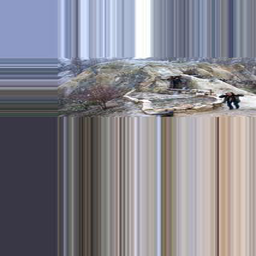

Processed 7000
Saved saved new images


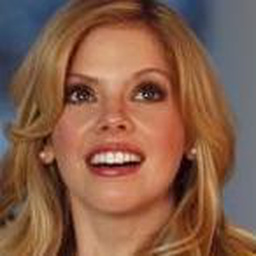

Saved saved new images


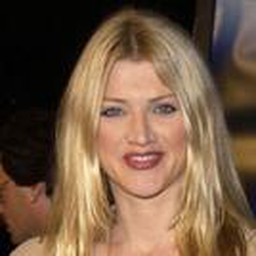

Saved saved new images


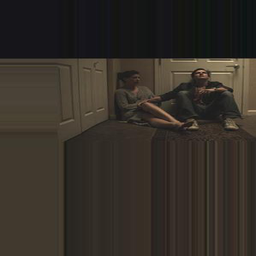

Processed 7500
Saved saved new images


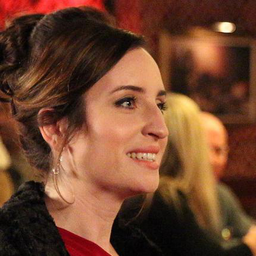

Saved saved new images


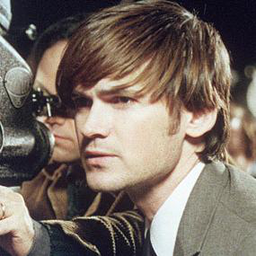

Processed 8000
Saved saved new images


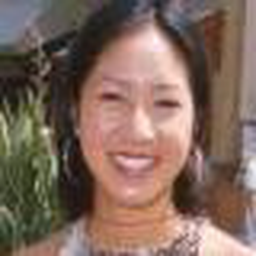

Saved saved new images


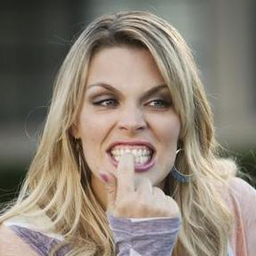

Saved saved new images


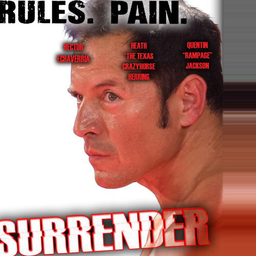

Processed 8500
Saved saved new images


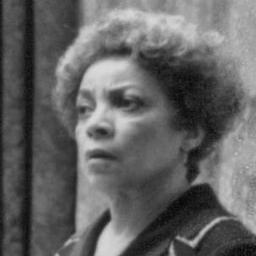

Saved saved new images


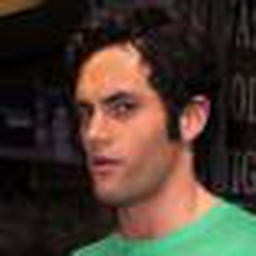

Processed 9000
Saved saved new images


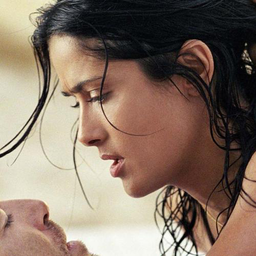

Saved saved new images


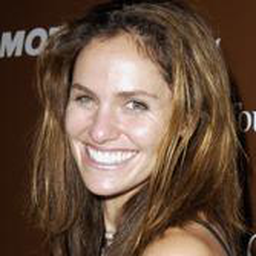

Saved saved new images


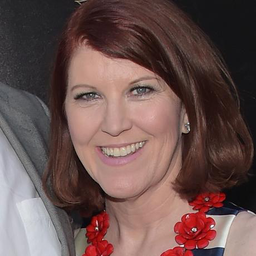

Processed 9500
Saved saved new images


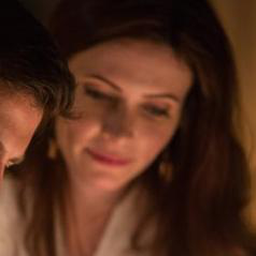

Saved saved new images


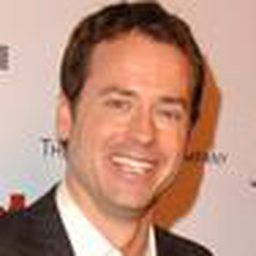

Processed 10000
Saved saved new images


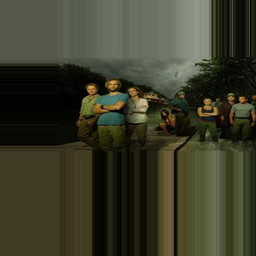

Saved saved new images


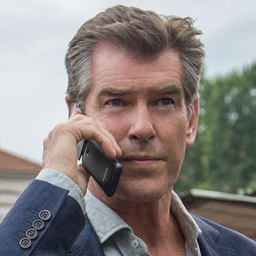

Saved saved new images


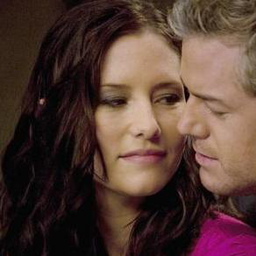

Processed 10500
Saved saved new images


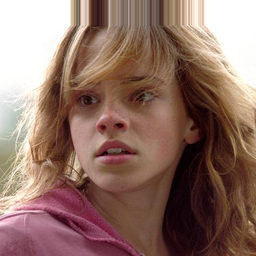

Saved saved new images


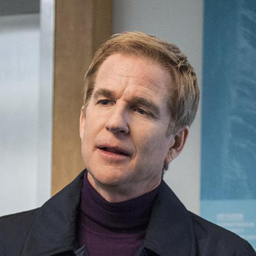

Processed 11000
Saved saved new images


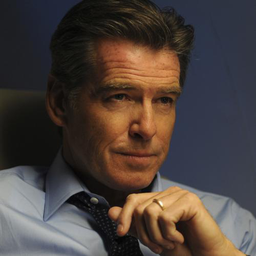

Saved saved new images


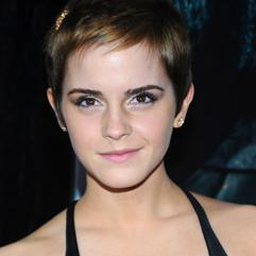

Saved saved new images


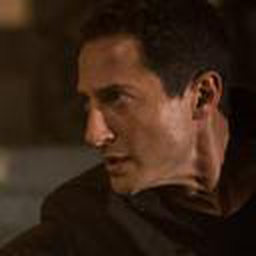

Processed 11500
Saved saved new images


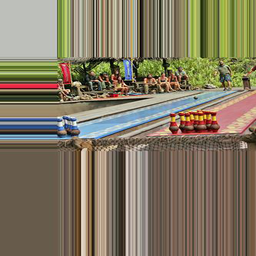

Saved saved new images


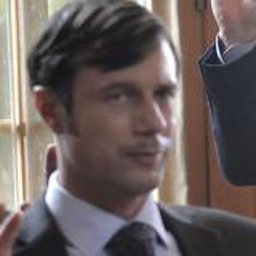

Processed 12000
Saved saved new images


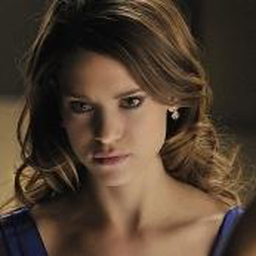

Saved saved new images


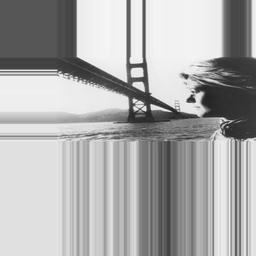

Saved saved new images


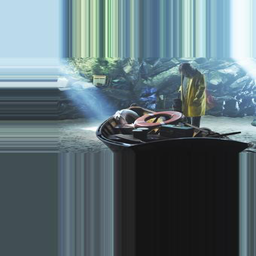

Processed 12500
Saved saved new images


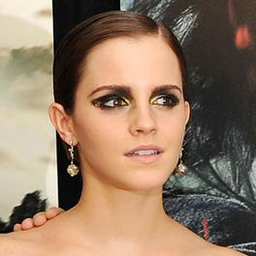

Saved saved new images


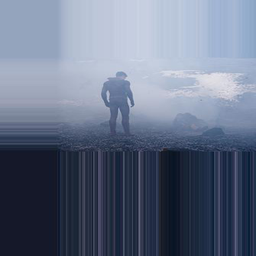

Processed 13000
Saved saved new images


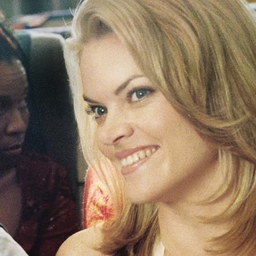

Saved saved new images


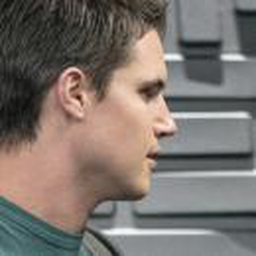

Saved saved new images


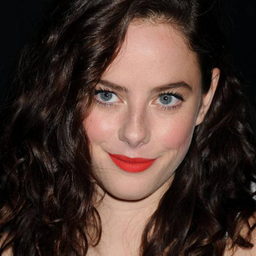

Processed 13500
Saved saved new images


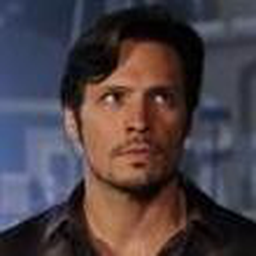

Saved saved new images


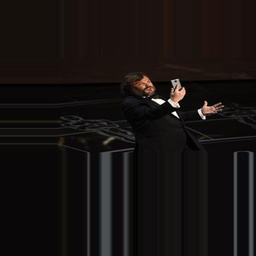

Processed 14000
Saved saved new images


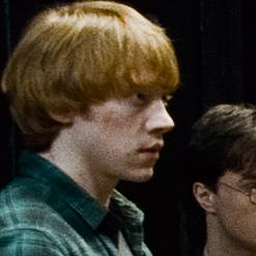

Saved saved new images


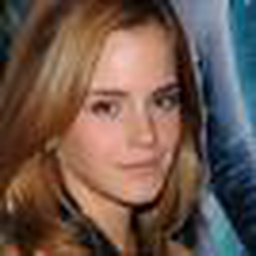

Saved saved new images


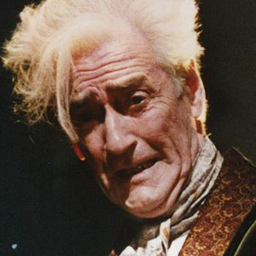

Processed 14500
Saved saved new images


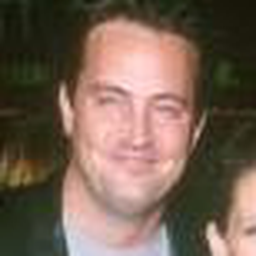

Saved saved new images


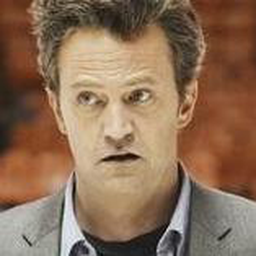

Processed 15000
Saved saved new images


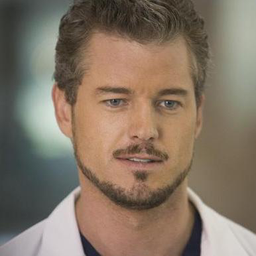

Saved saved new images


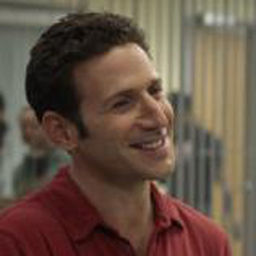

Saved saved new images


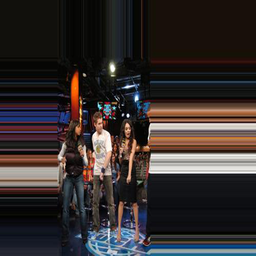

Processed 15500
Saved saved new images


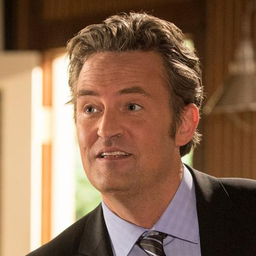

Saved saved new images


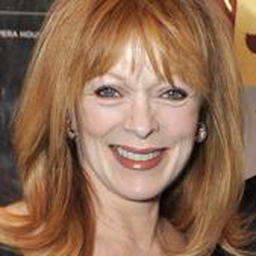

Processed 16000
Saved saved new images


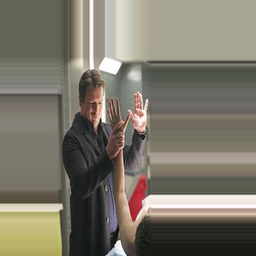

Saved saved new images


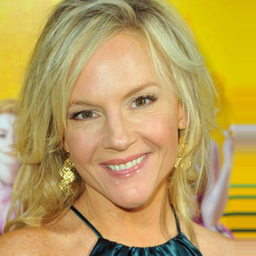

Saved saved new images


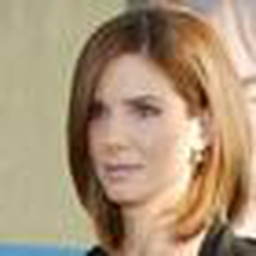

Processed 16500
Saved saved new images


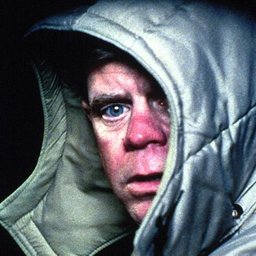

Saved saved new images


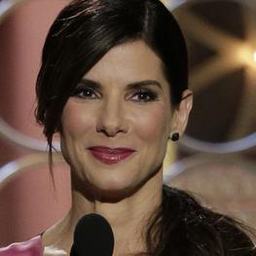

Processed 17000
Saved saved new images


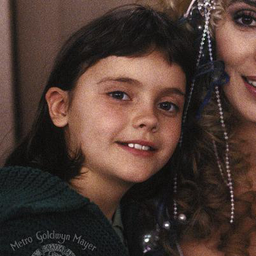

Saved saved new images


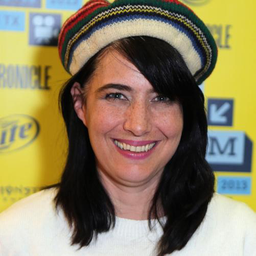

Saved saved new images


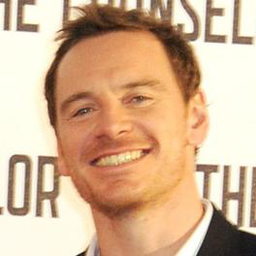

Processed 17500
Saved saved new images


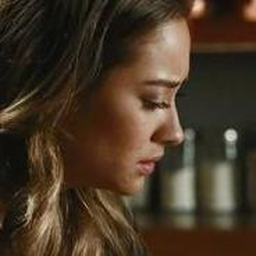

Saved saved new images


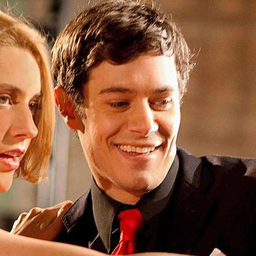

Processed 18000
Saved saved new images


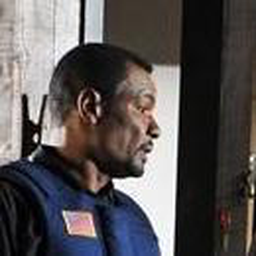

Saved saved new images


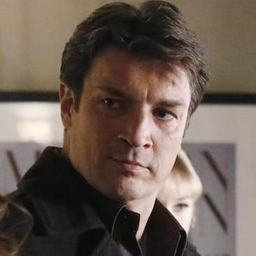

Saved saved new images


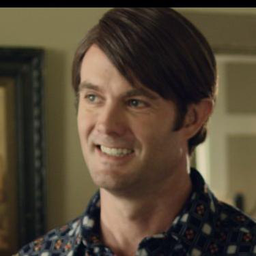

Processed 18500
Saved saved new images


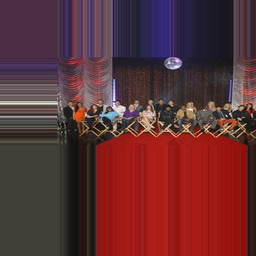

Saved saved new images


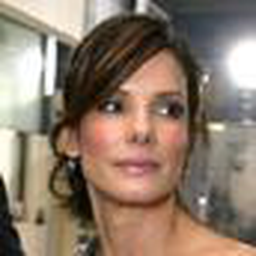

Processed 19000
Saved saved new images


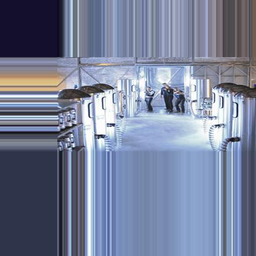

Saved saved new images


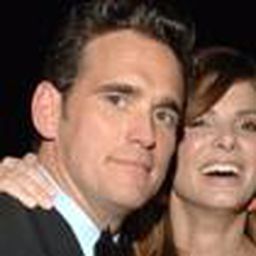

Saved saved new images


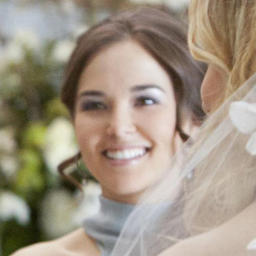

Processed 19500
Saved saved new images


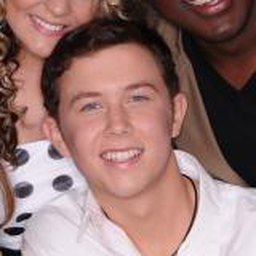

Saved saved new images


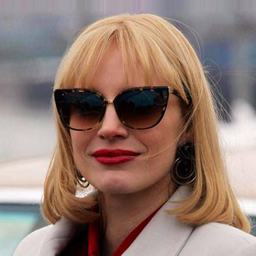

Processed 20000
Saved saved new images


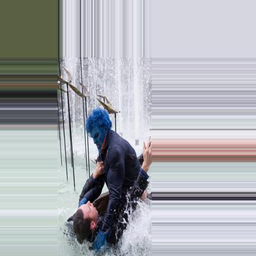

Saved saved new images


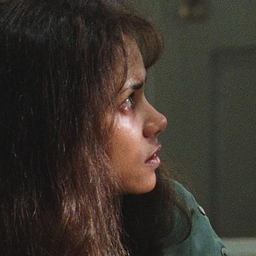

Saved saved new images


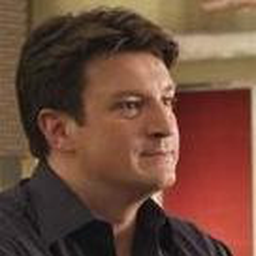

Processed 20500
Saved saved new images


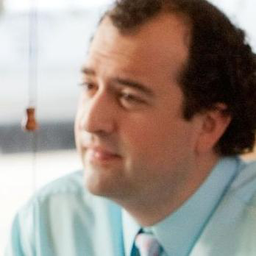

Saved saved new images


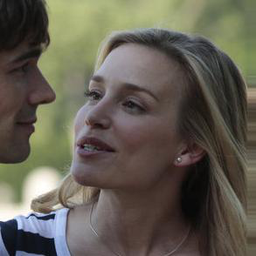

Processed 21000
Saved saved new images


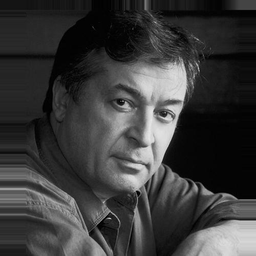

Saved saved new images


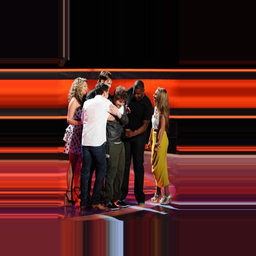

Saved saved new images


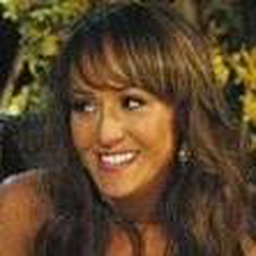

Processed 21500
Saved saved new images


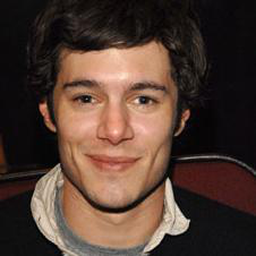

Saved saved new images


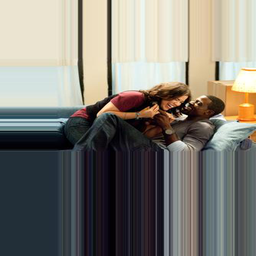

Processed 22000
Saved saved new images


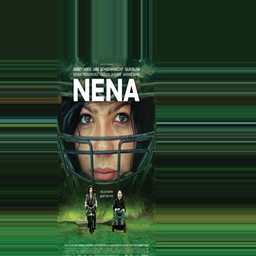

Saved saved new images


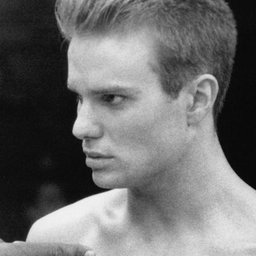

Saved saved new images


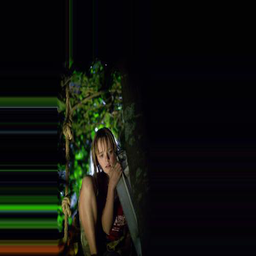

Processed 22500
Saved saved new images


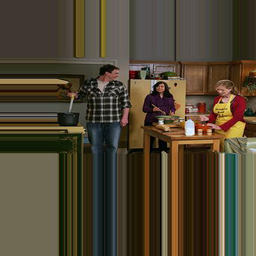

Saved saved new images


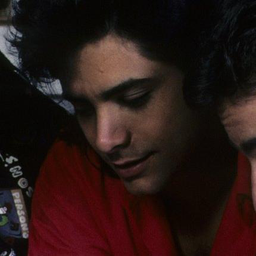

Processed 23000
Saved saved new images


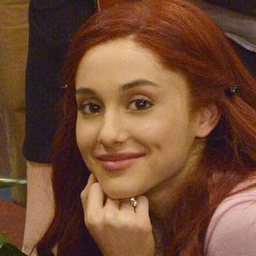

Saved saved new images


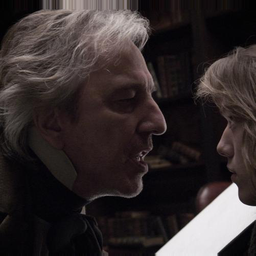

Saved saved new images


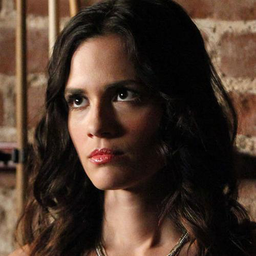

Processed 23500
Saved saved new images


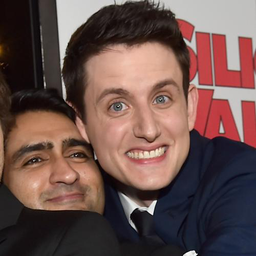

Saved saved new images


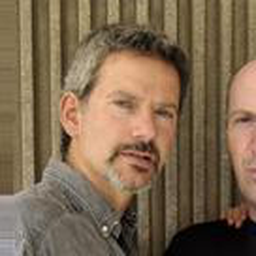

Processed 24000
Saved saved new images


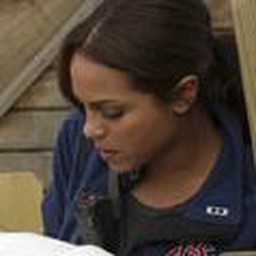

Saved saved new images


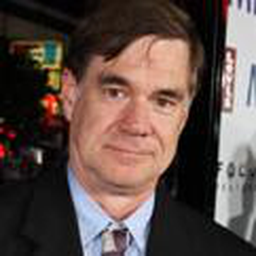

Saved saved new images


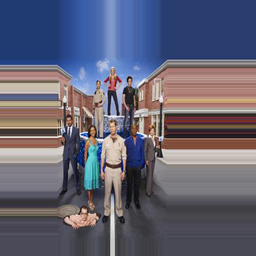

Processed 24500
Saved saved new images


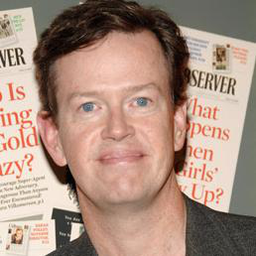

Saved saved new images


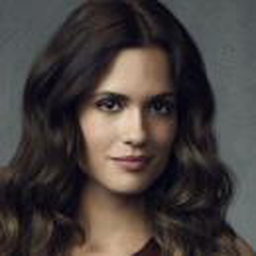

Processed 25000
Saved saved new images


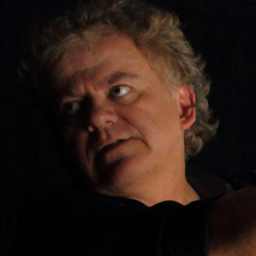

Saved saved new images


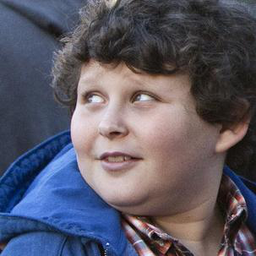

Saved saved new images


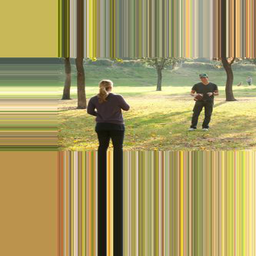

Processed 25500
Saved saved new images


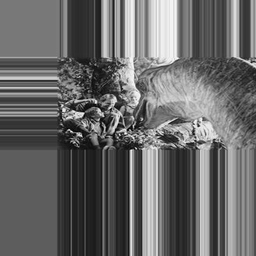

Saved saved new images


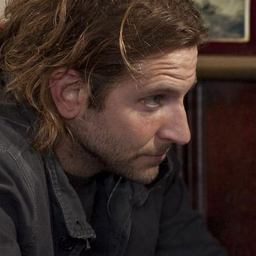

Processed 26000
Saved saved new images


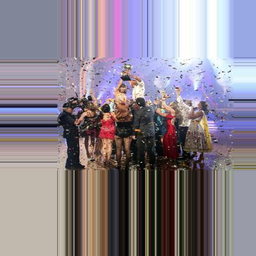

Saved saved new images


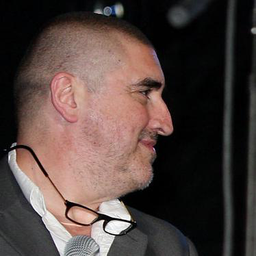

Saved saved new images


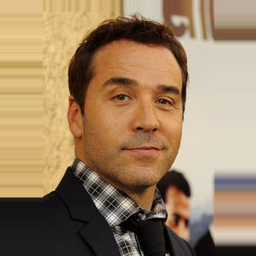

Processed 26500
Saved saved new images


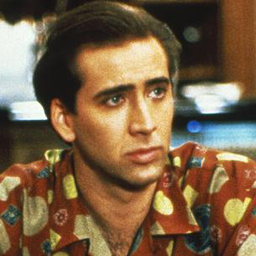

Saved saved new images


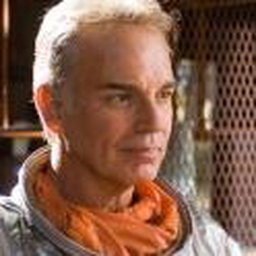

Processed 27000
Saved saved new images


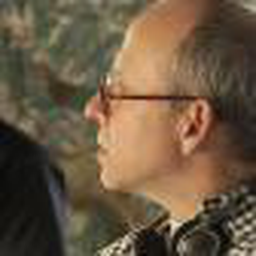

Saved saved new images


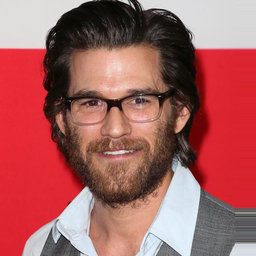

Saved saved new images


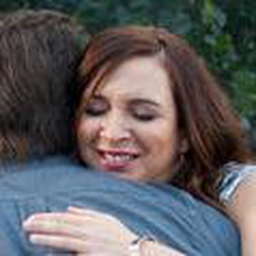

Processed 27500
Saved saved new images


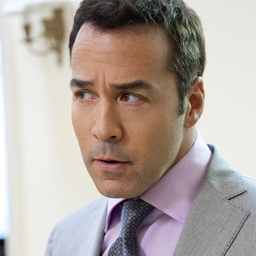

Saved saved new images


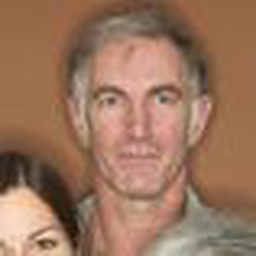

Processed 28000
Saved saved new images


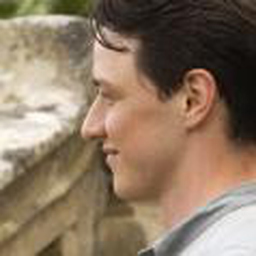

Saved saved new images


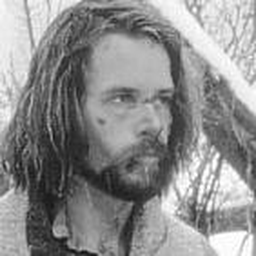

Saved saved new images


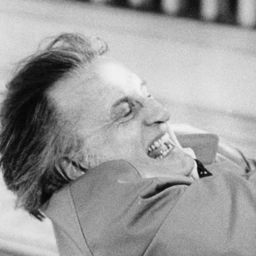

Processed 28500
Saved saved new images


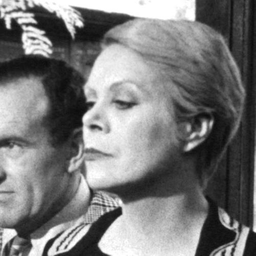

Saved saved new images


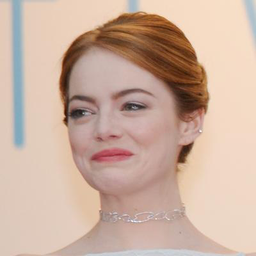

Processed 29000
Saved saved new images


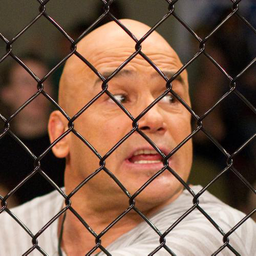

Saved saved new images


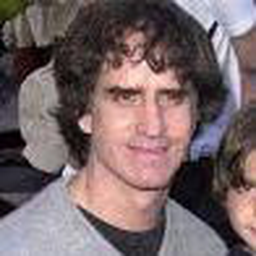

Saved saved new images


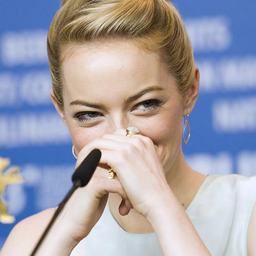

Processed 29500
Saved saved new images


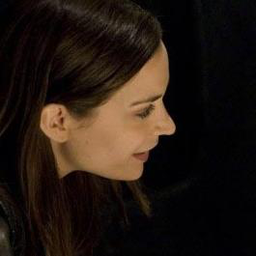

Saved saved new images


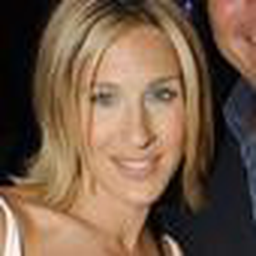

Processed 30000
Saved saved new images


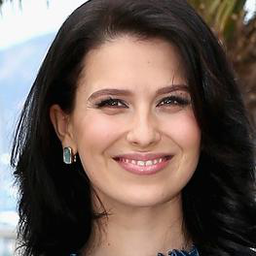

Saved saved new images


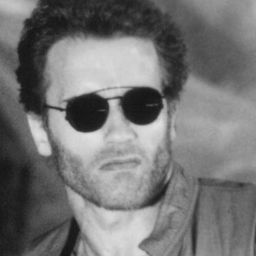

Saved saved new images


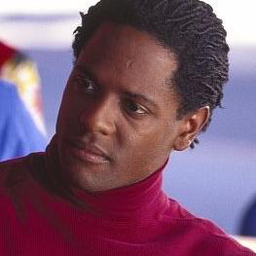

Processed 30500
Saved saved new images


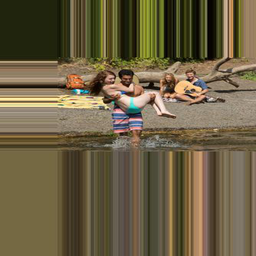

Saved saved new images


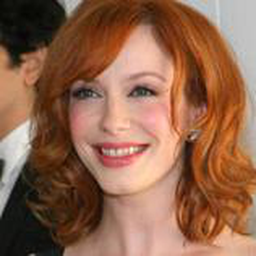

Processed 31000
Saved saved new images


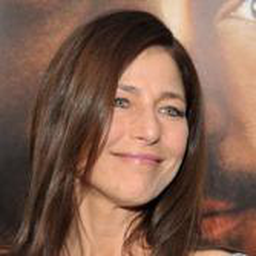

Saved saved new images


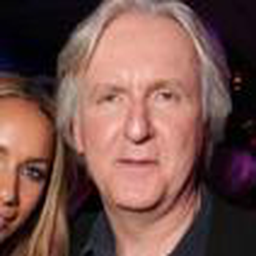

Saved saved new images


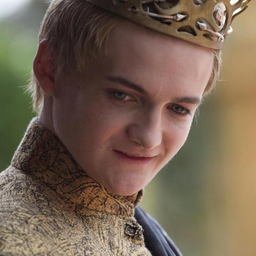

Processed 31500
Saved saved new images


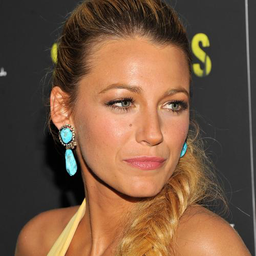

Saved saved new images


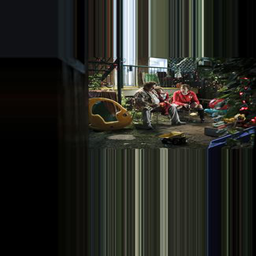

Processed 32000
Saved saved new images


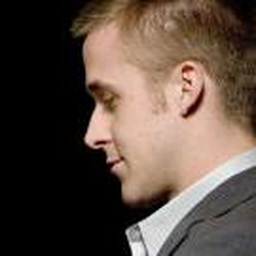

Saved saved new images


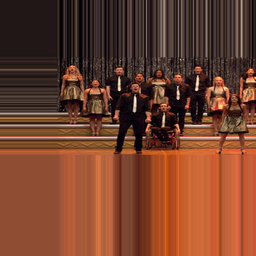

Saved saved new images


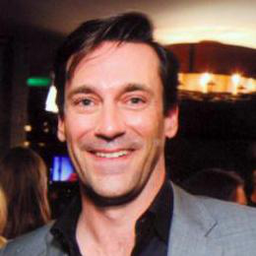

Processed 32500
Saved saved new images


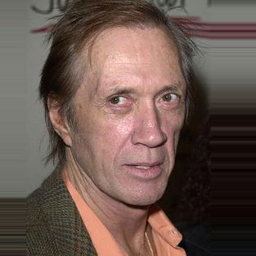

Saved saved new images


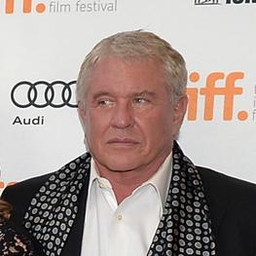

Processed 33000
Saved saved new images


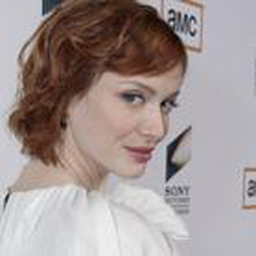

Saved saved new images


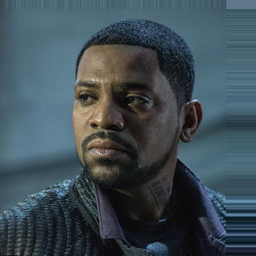

Saved saved new images


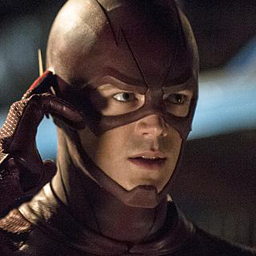

Processed 33500
Saved saved new images


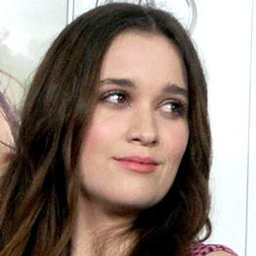

Saved saved new images


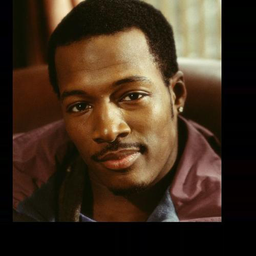

Processed 34000
Saved saved new images


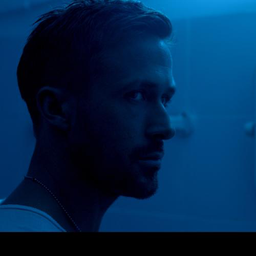

Saved saved new images


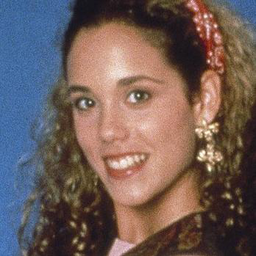

Saved saved new images


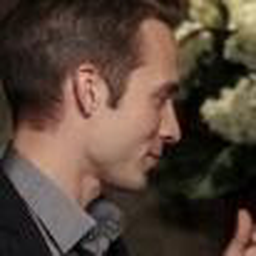

Processed 34500
Saved saved new images


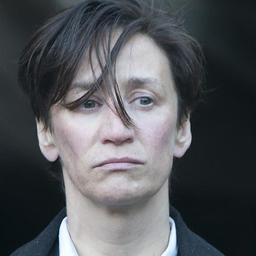

Saved saved new images


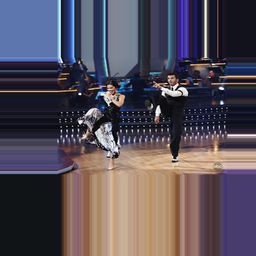

Processed 35000
Saved saved new images


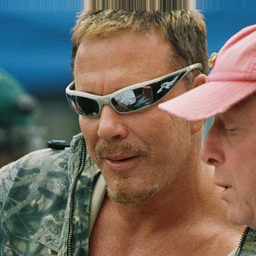

Saved saved new images


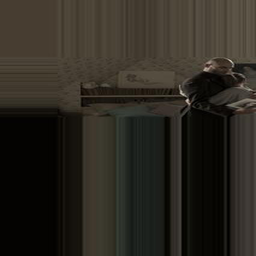

Saved saved new images


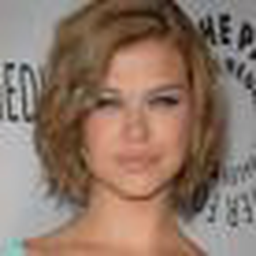

Processed 35500
Saved saved new images


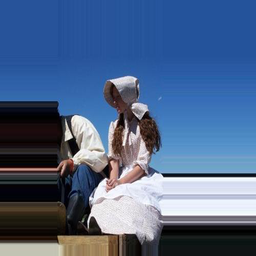

Saved saved new images


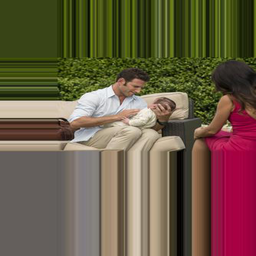

Processed 36000
Saved saved new images


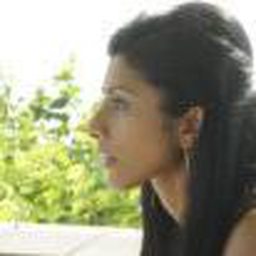

Saved saved new images


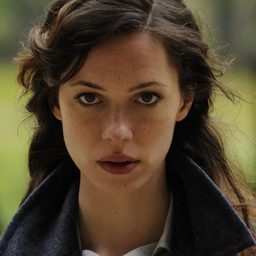

Saved saved new images


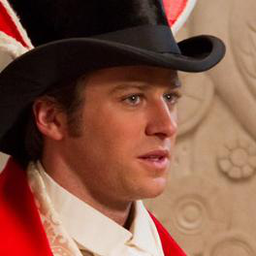

Processed 36500
Saved saved new images


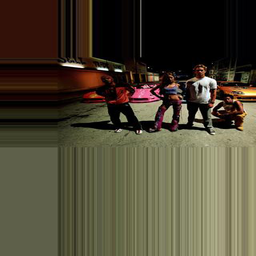

Saved saved new images


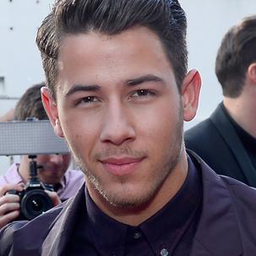

Processed 37000
Saved saved new images


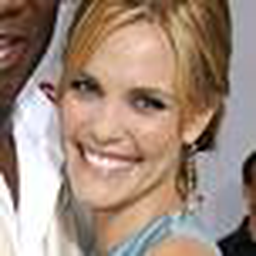

Saved saved new images


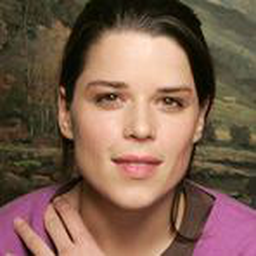

Saved saved new images


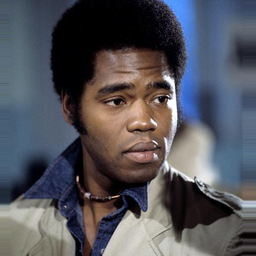

Processed 37500
Saved saved new images


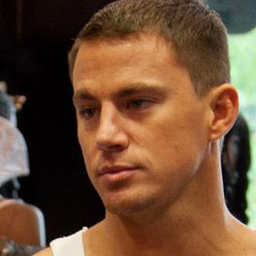

Saved saved new images


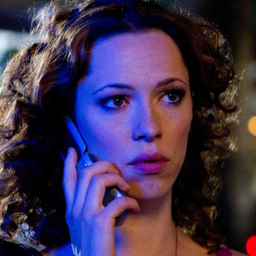

Processed 38000
Saved saved new images


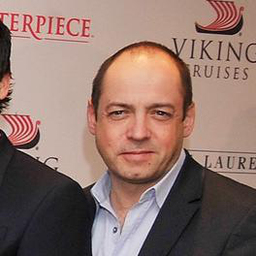

Saved saved new images


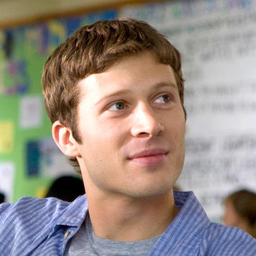

Saved saved new images


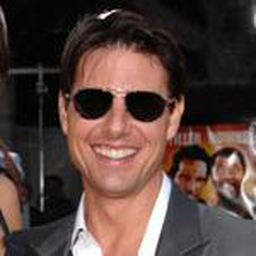

Processed 38500
Saved saved new images


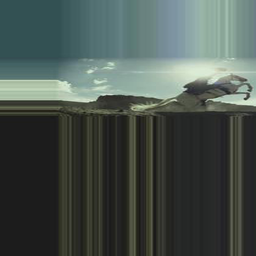

Saved saved new images


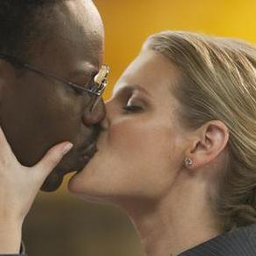

Processed 39000
Saved saved new images


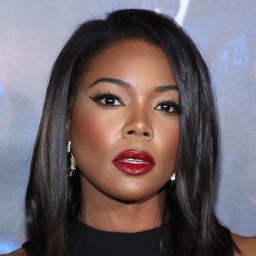

Saved saved new images


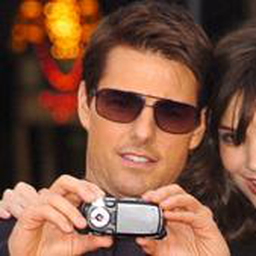

Saved saved new images


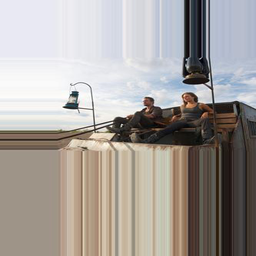

Processed 39500
Saved saved new images


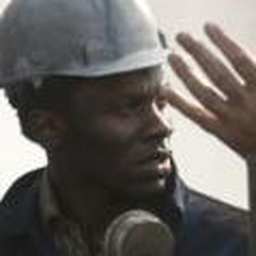

Saved saved new images


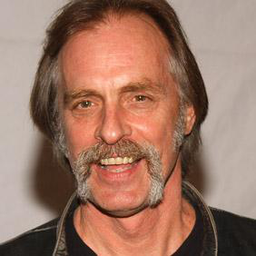

Processed 40000
Saved saved new images


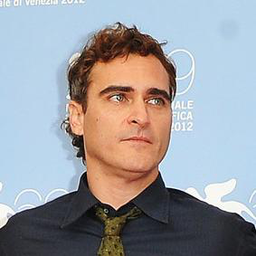

Saved saved new images


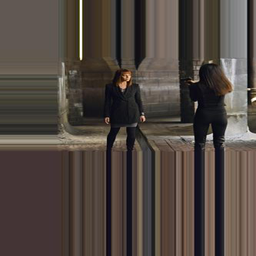

Saved saved new images


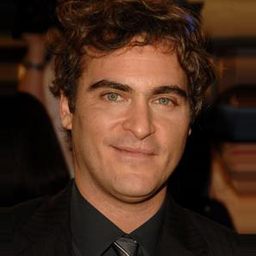

Processed 40500
Saved saved new images


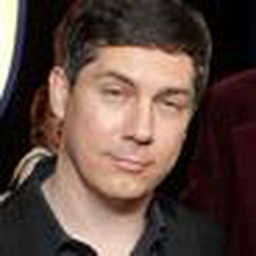

Saved saved new images


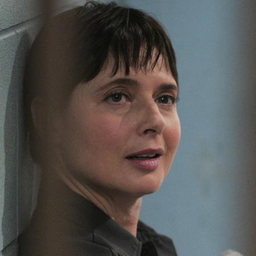

Processed 41000
Saved saved new images


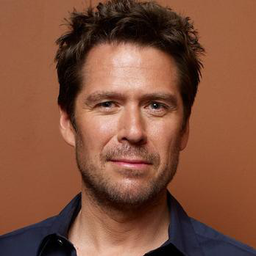

Saved saved new images


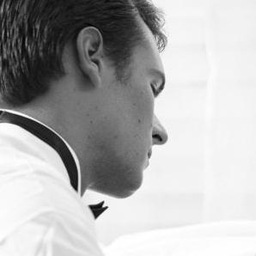

Saved saved new images


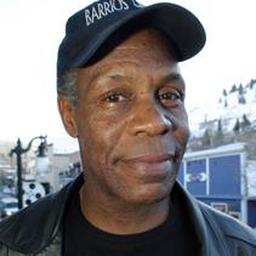

Processed 41500
Saved saved new images


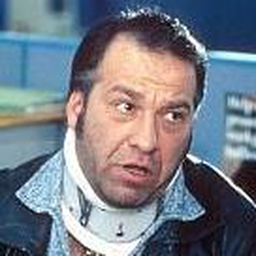

Saved saved new images


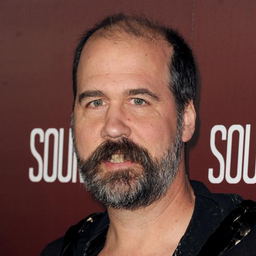

Processed 42000
Saved saved new images


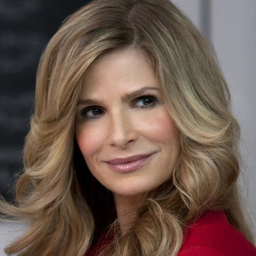

Saved saved new images


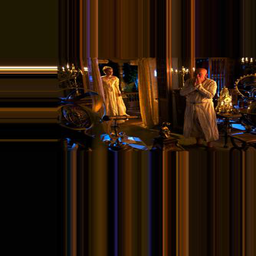

Saved saved new images


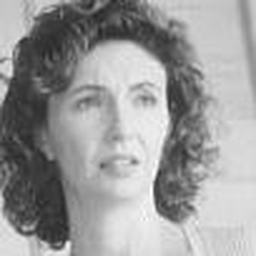

Processed 42500
Saved saved new images


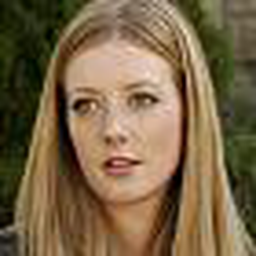

Saved saved new images


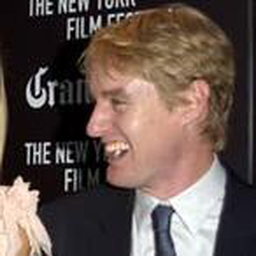

Processed 43000
Saved saved new images


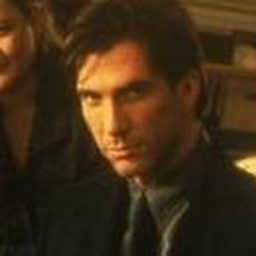

Saved saved new images


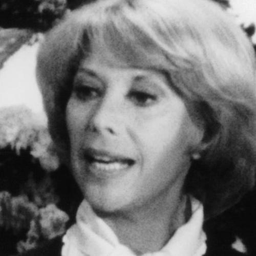

Saved saved new images


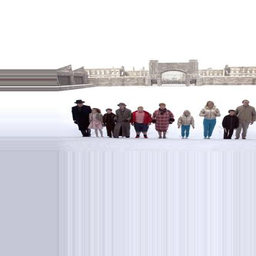

Processed 43500
Saved saved new images


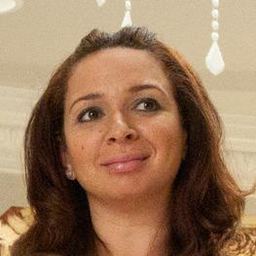

Saved saved new images


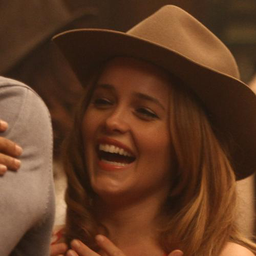

Processed 44000
Saved saved new images


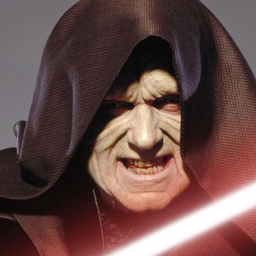

Saved saved new images


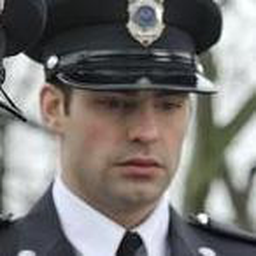

Saved saved new images


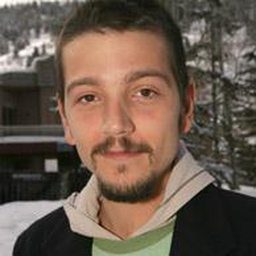

Processed 44500
Saved saved new images


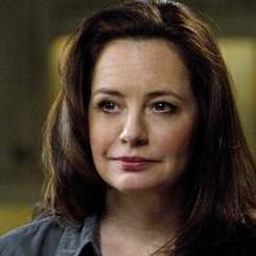

Saved saved new images


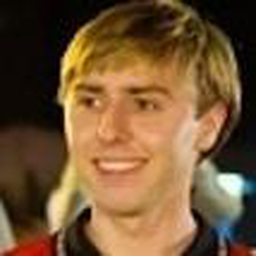

Processed 45000
Saved saved new images


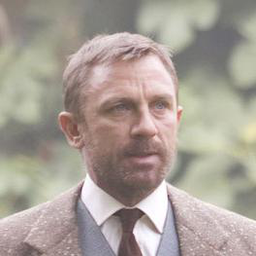

Saved saved new images


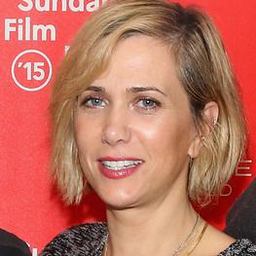

Saved saved new images


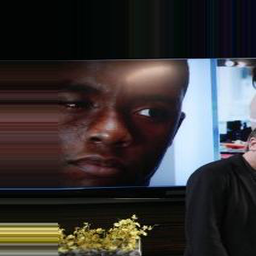

Processed 45500
Saved saved new images


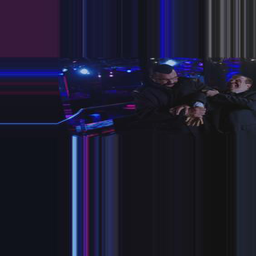

Saved saved new images


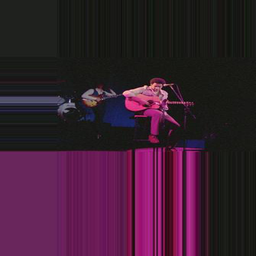

Processed 46000
Saved saved new images


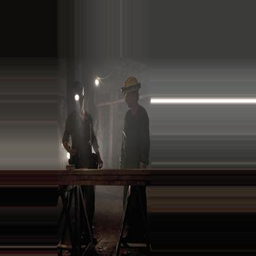

Saved saved new images


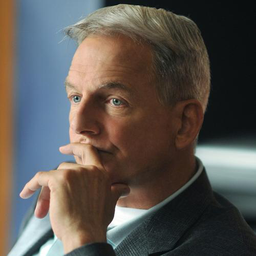

Saved saved new images


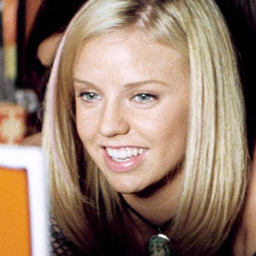

Processed 46500
Saved saved new images


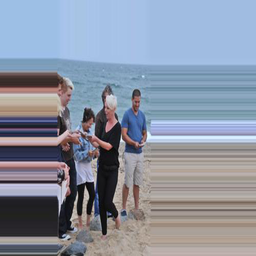

Saved saved new images


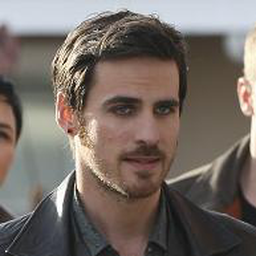

Processed 47000
Saved saved new images


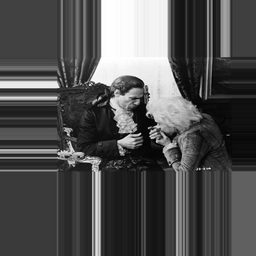

Saved saved new images


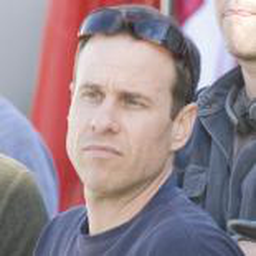

Saved saved new images


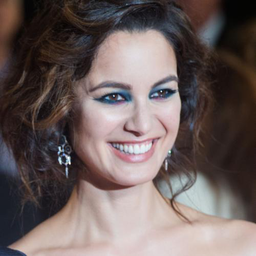

Processed 47500
Saved saved new images


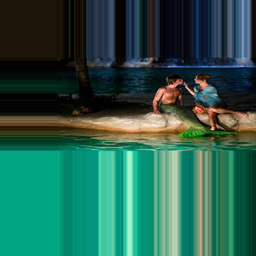

Saved saved new images


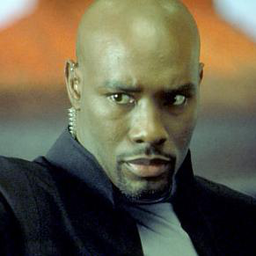

Processed 48000
Saved saved new images


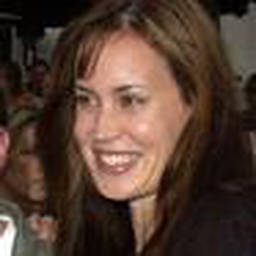

Saved saved new images


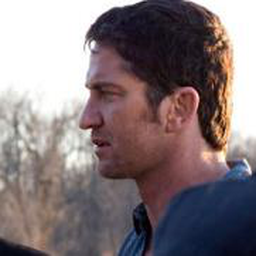

Saved saved new images


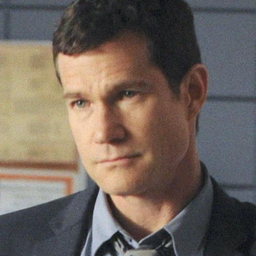

Processed 48500
Saved saved new images


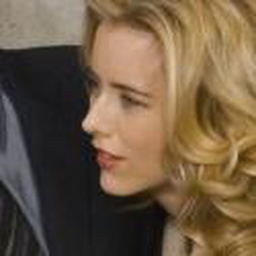

Saved saved new images


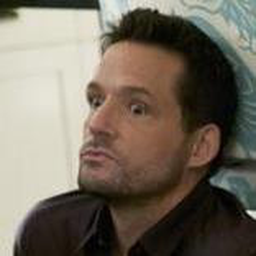

Processed 49000
Saved saved new images


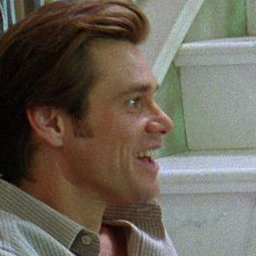

Saved saved new images


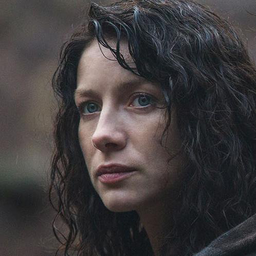

Saved saved new images


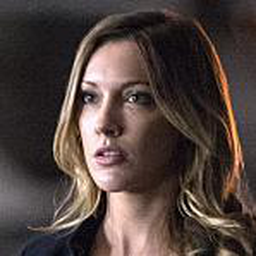

Processed 49500
Saved saved new images


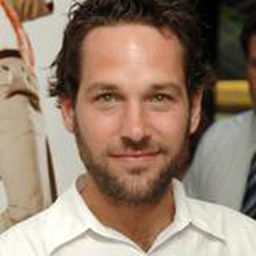

Saved saved new images


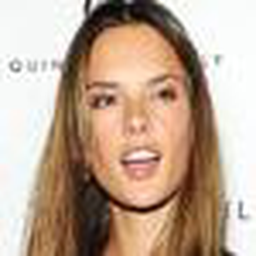

Processed 50000
Saved saved new images


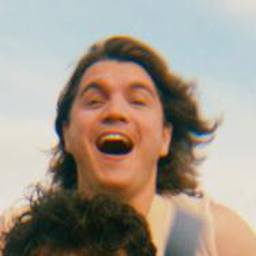

Saved saved new images


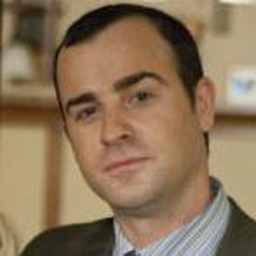

Saved saved new images


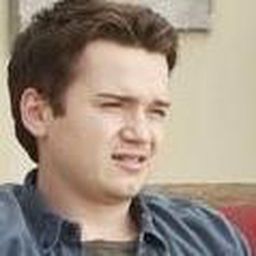

Processed 50500
Saved saved new images


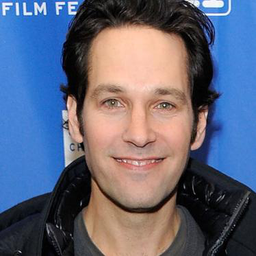

Saved saved new images


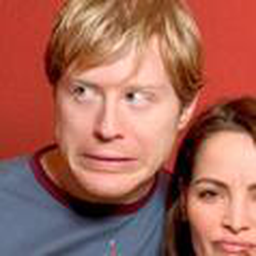

Processed 51000
Saved saved new images


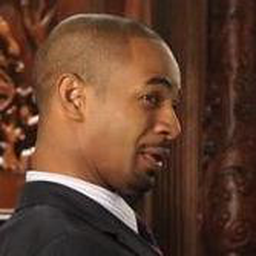

Saved saved new images


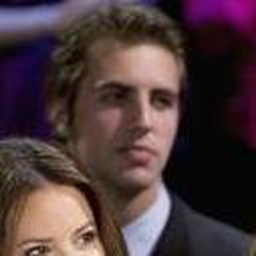

Saved saved new images


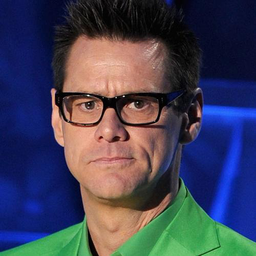

Processed 51500
Saved saved new images


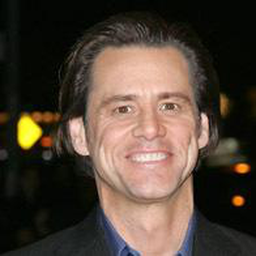

Saved saved new images


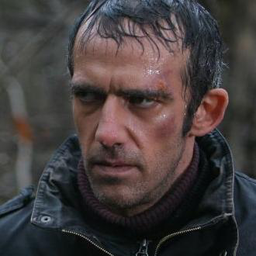

Processed 52000
Saved saved new images


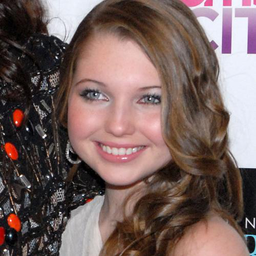

Saved saved new images


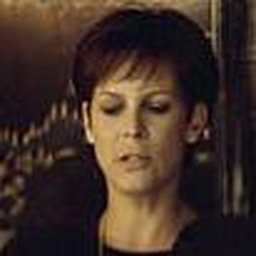

COMPRESSING (1/2)    from    /content/IMDB_2/batch-3    to    /tmp_/batch-3-num_pic-46989-id-1896.zip
UPLOADING FILE (2/2)    from    /tmp_/batch-3-num_pic-46989-id-1896.zip    to    gs://ntnu-ml-bucket/IMDB/batches/batch-3-num_pic-46989-id-1896.zip
Successfully backed up 46989 pictures
Saved saved new images


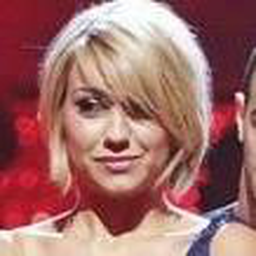

Processed 52500
Saved saved new images


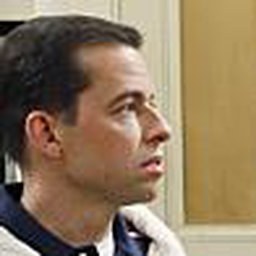

Saved saved new images


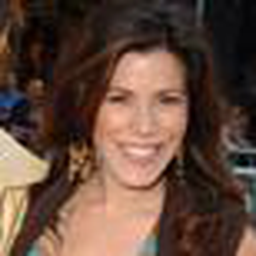

Processed 53000
Saved saved new images


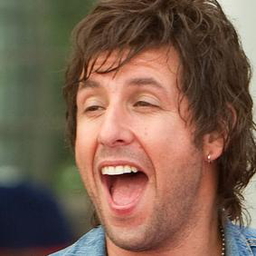

Saved saved new images


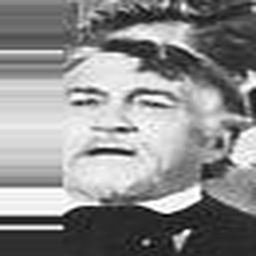

Saved saved new images


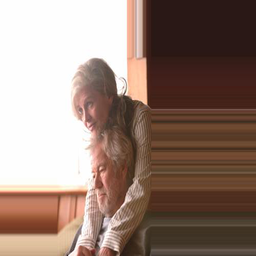

Processed 53500
Saved saved new images


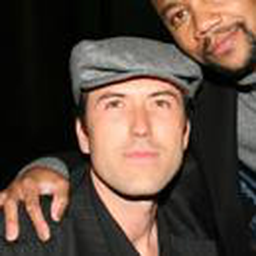

Saved saved new images


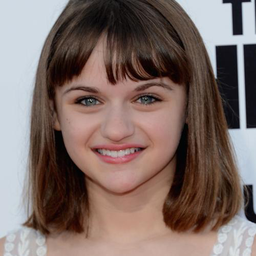

Processed 54000
Saved saved new images


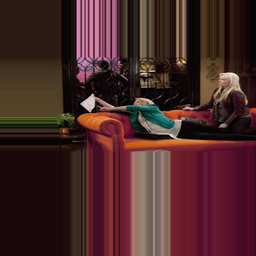

Saved saved new images


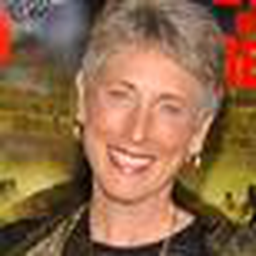

Saved saved new images


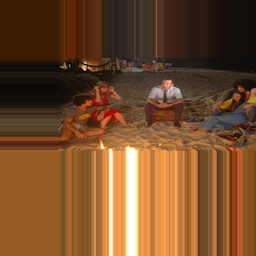

Processed 54500
Saved saved new images


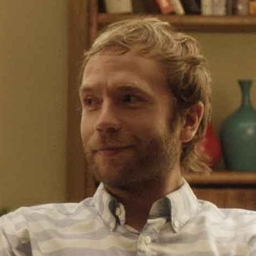

Saved saved new images


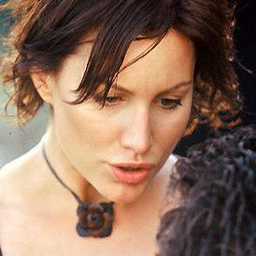

Processed 55000
Saved saved new images


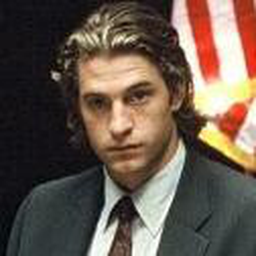

Saved saved new images


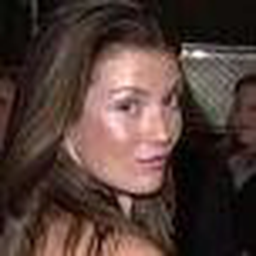

Saved saved new images


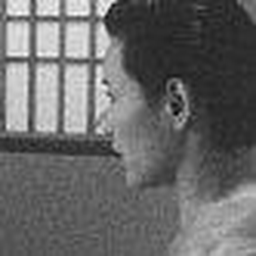

Processed 55500
Saved saved new images


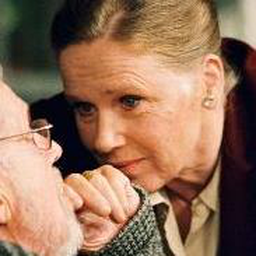

Saved saved new images


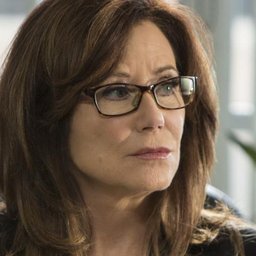

Processed 56000
Saved saved new images


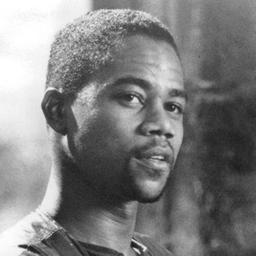

Saved saved new images


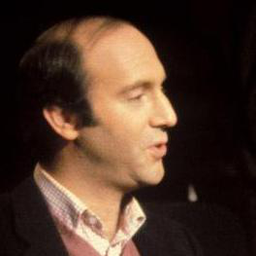

Saved saved new images


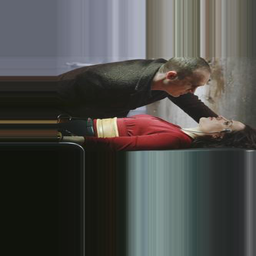

Processed 56500
Saved saved new images


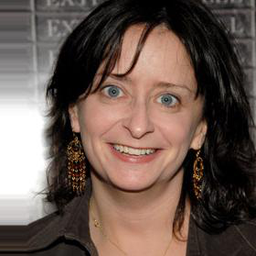

Saved saved new images


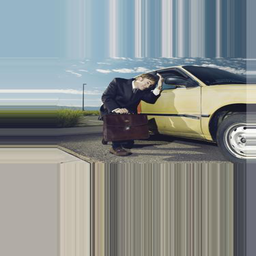

Processed 57000
Saved saved new images


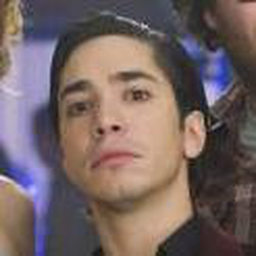

Saved saved new images


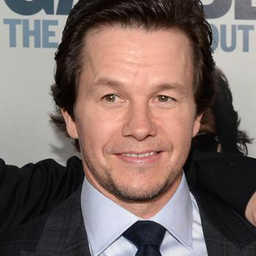

Saved saved new images


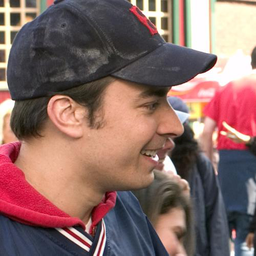

Processed 57500
Saved saved new images


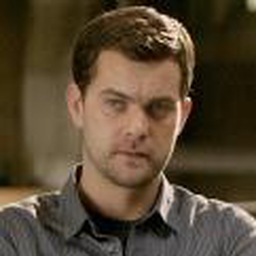

Saved saved new images


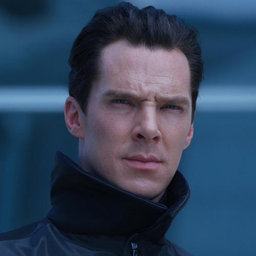

Processed 58000
Saved saved new images


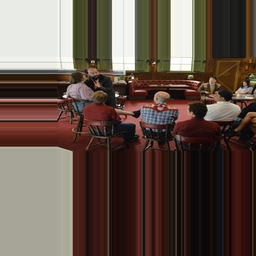

Saved saved new images


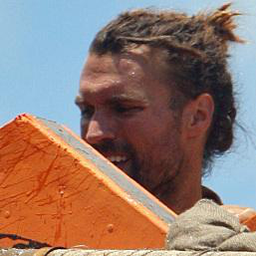

Saved saved new images


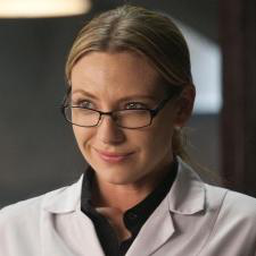

Processed 58500
Saved saved new images


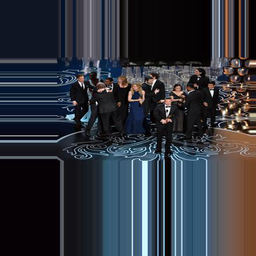

Saved saved new images


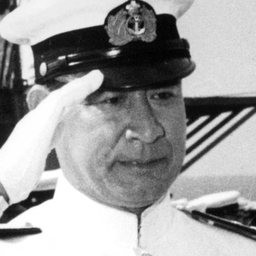

Processed 59000
Saved saved new images


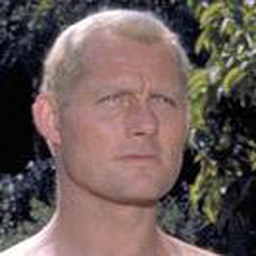

Saved saved new images


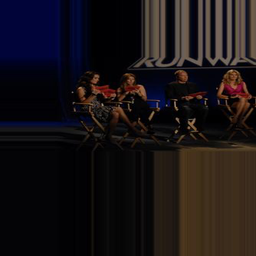

Saved saved new images


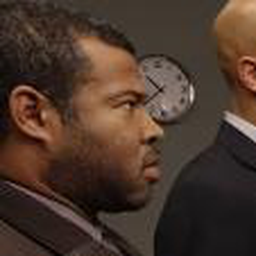

Processed 59500
Saved saved new images


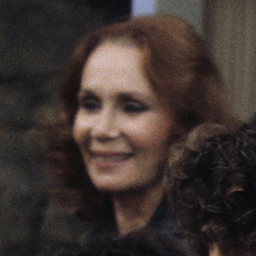

Saved saved new images


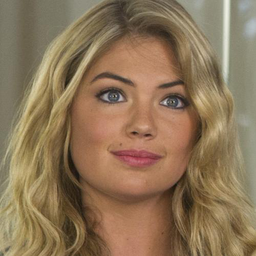

Processed 60000
Saved saved new images


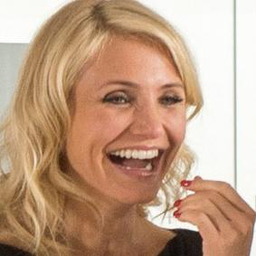

Saved saved new images


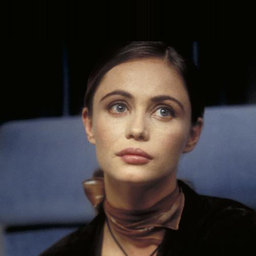

Saved saved new images


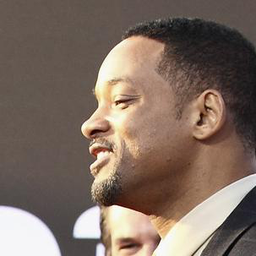

Processed 60500
Saved saved new images


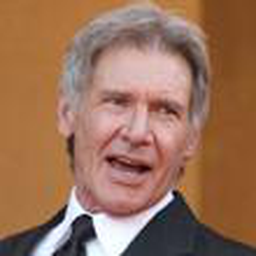

Saved saved new images


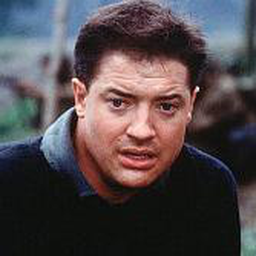

Processed 61000
Saved saved new images


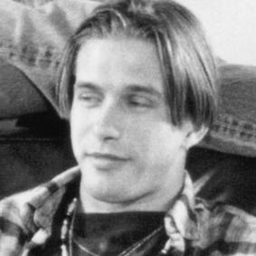

Saved saved new images


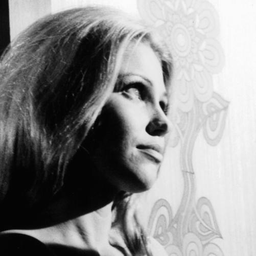

Saved saved new images


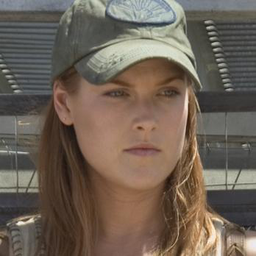

Processed 61500
Saved saved new images


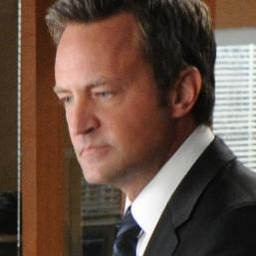

Saved saved new images


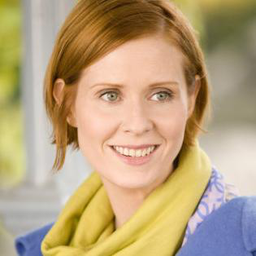

Processed 62000
Saved saved new images


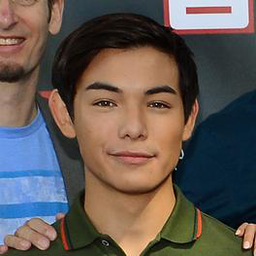

Saved saved new images


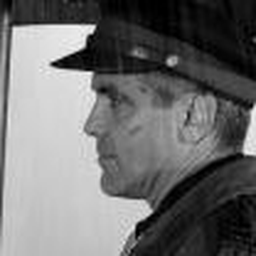

Saved saved new images


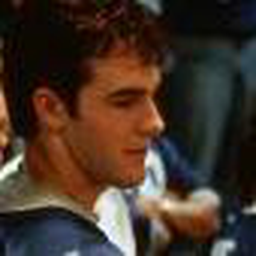

Processed 62500
Saved saved new images


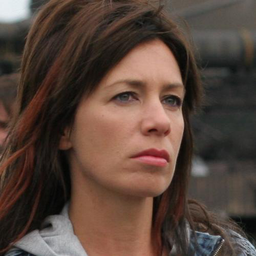

Saved saved new images


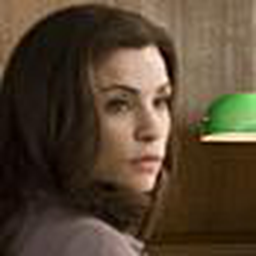

Processed 63000
Saved saved new images


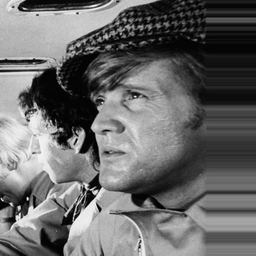

Saved saved new images


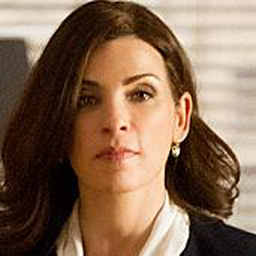

Saved saved new images


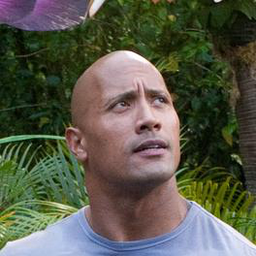

Processed 63500
Saved saved new images


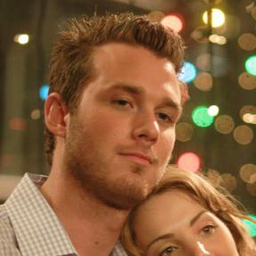

Saved saved new images


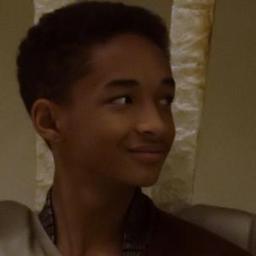

Processed 64000
Saved saved new images


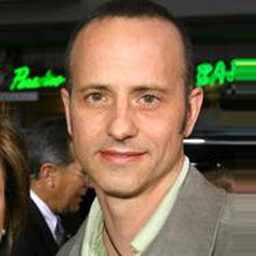

Saved saved new images


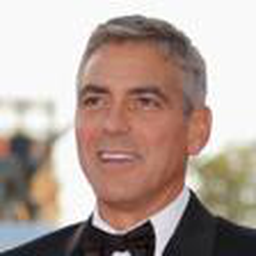

Saved saved new images


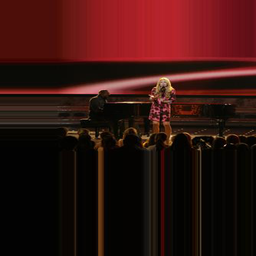

Processed 64500
Saved saved new images


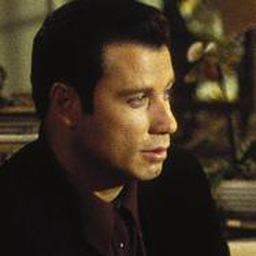

Saved saved new images


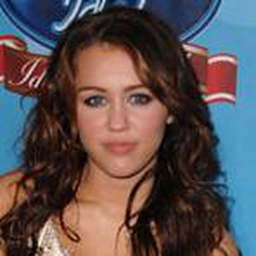

Processed 65000
Saved saved new images


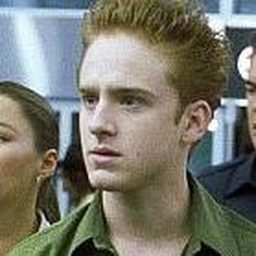

Saved saved new images


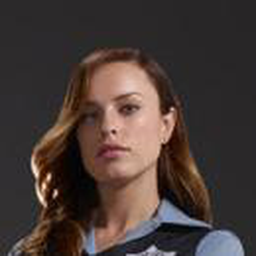

Saved saved new images


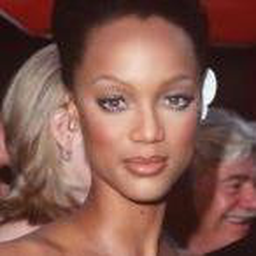

Processed 65500
Saved saved new images


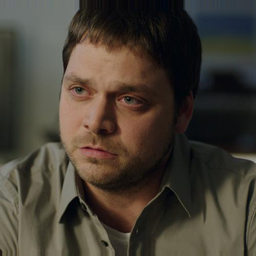

Saved saved new images


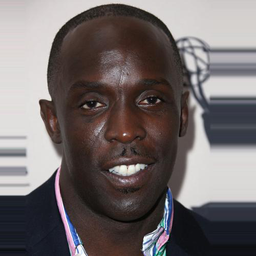

Processed 66000
Saved saved new images


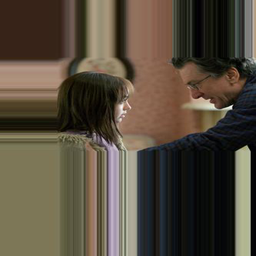

Saved saved new images


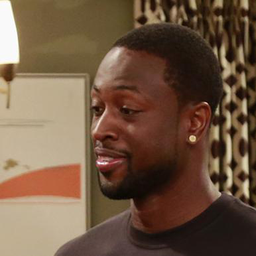

Saved saved new images


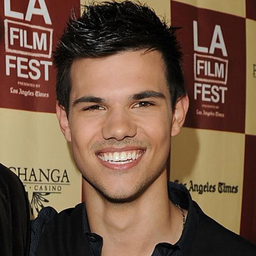

Processed 66500
Saved saved new images


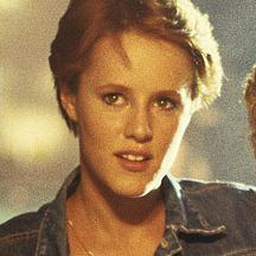

Saved saved new images


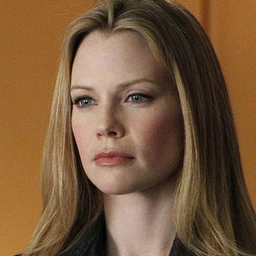

Processed 67000
Saved saved new images


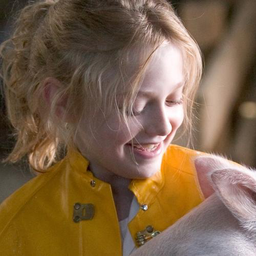

Saved saved new images


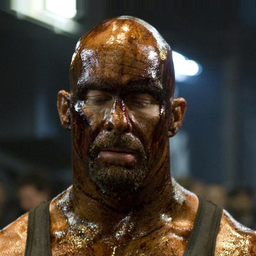

Saved saved new images


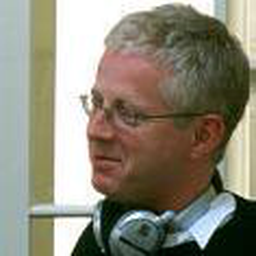

Processed 67500
Saved saved new images


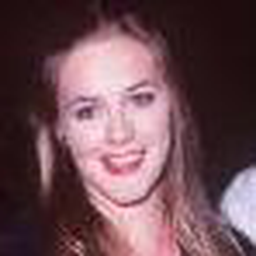

Saved saved new images


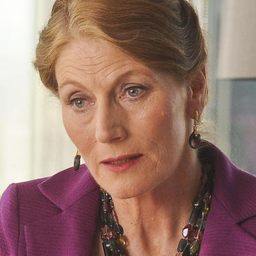

Processed 68000
Saved saved new images


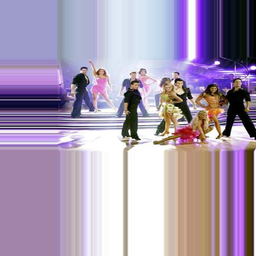

Saved saved new images


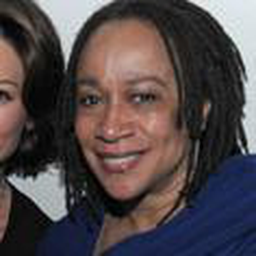

Saved saved new images


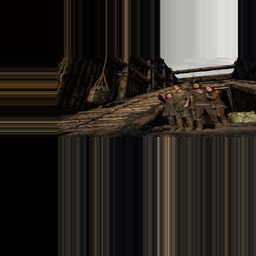

Processed 68500
Saved saved new images


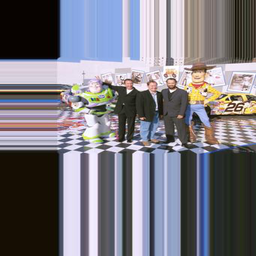

Saved saved new images


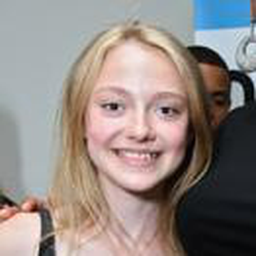

Processed 69000
Saved saved new images


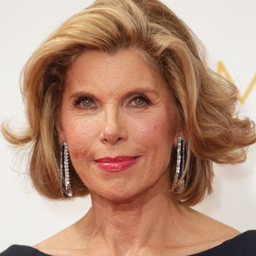

Saved saved new images


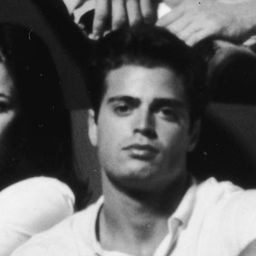

Saved saved new images


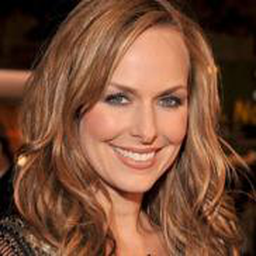

Processed 69500
Saved saved new images


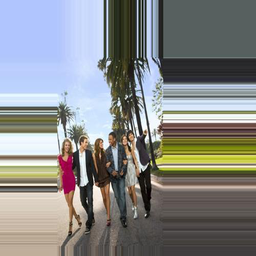

Saved saved new images


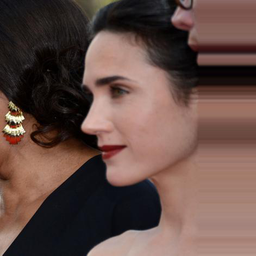

Processed 70000
Saved saved new images


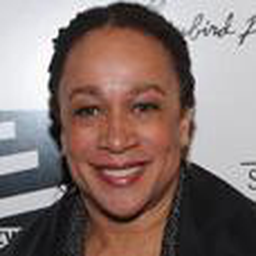

Saved saved new images


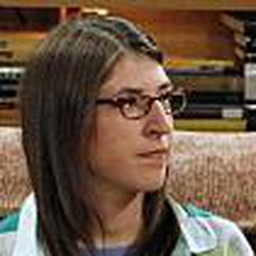

Saved saved new images


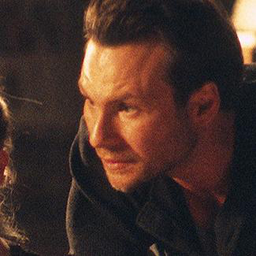

Processed 70500
Saved saved new images


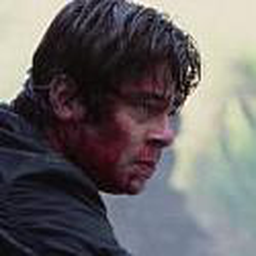

Saved saved new images


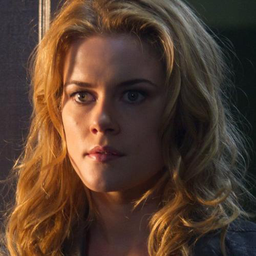

Processed 71000
Saved saved new images


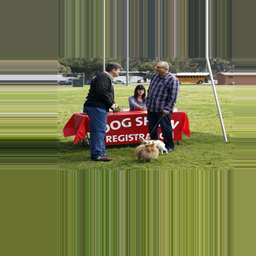

Saved saved new images


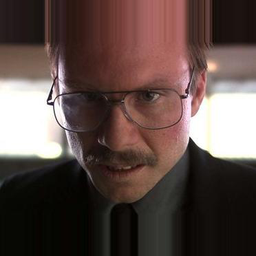

Saved saved new images


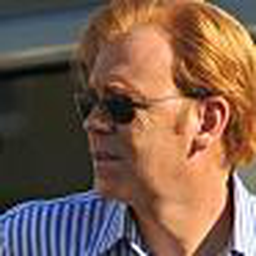

Processed 71500
Saved saved new images


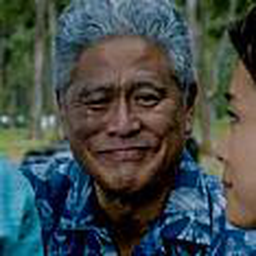

Saved saved new images


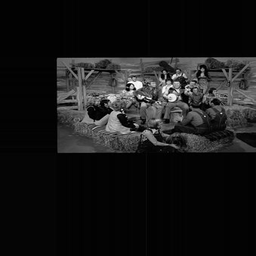

Processed 72000
Saved saved new images


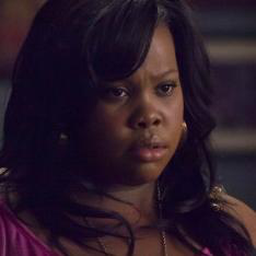

Saved saved new images


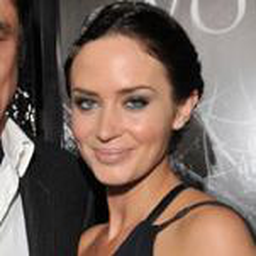

Saved saved new images


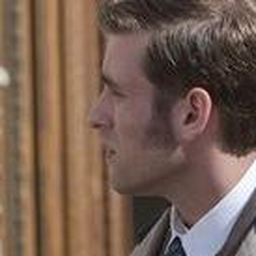

Processed 72500
Saved saved new images


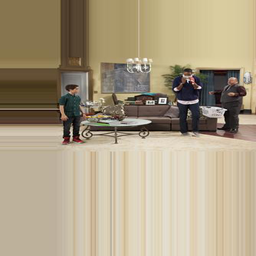

Saved saved new images


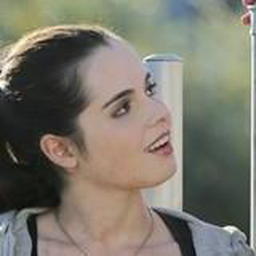

Processed 73000
Saved saved new images


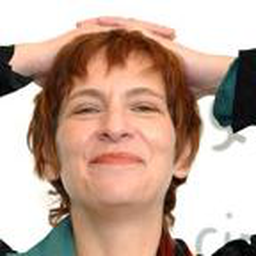

Saved saved new images


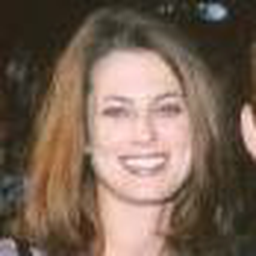

Saved saved new images


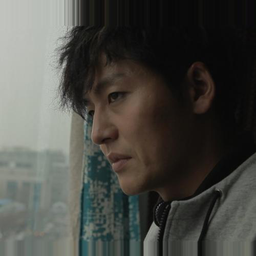

Processed 73500
Saved saved new images


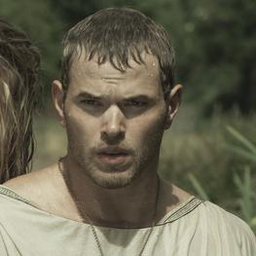

Saved saved new images


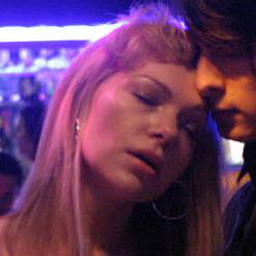

Processed 74000
Saved saved new images


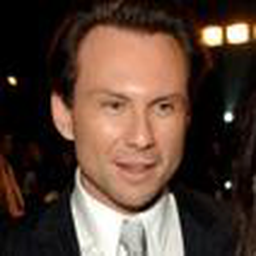

Saved saved new images


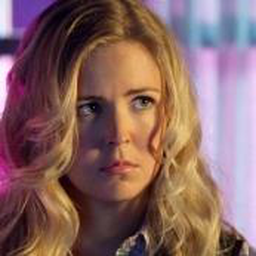

Saved saved new images


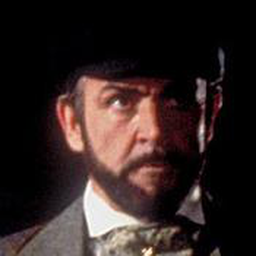

Processed 74500
Saved saved new images


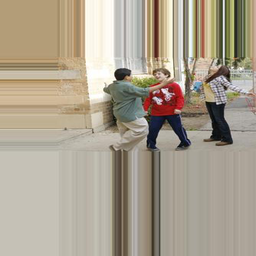

Saved saved new images


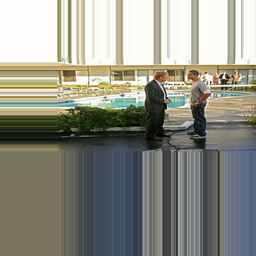

Processed 75000
Saved saved new images


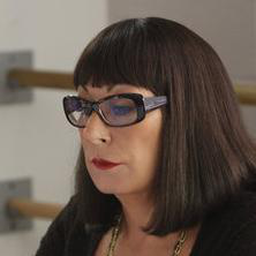

Saved saved new images


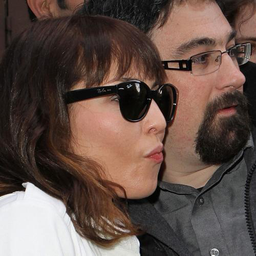

Saved saved new images


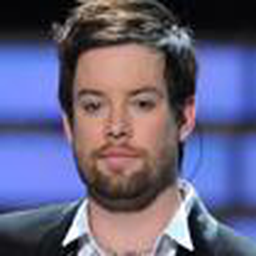

Processed 75500
Saved saved new images


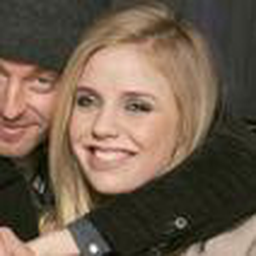

Saved saved new images


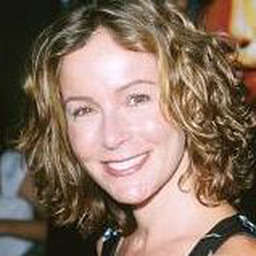

Processed 76000
Saved saved new images


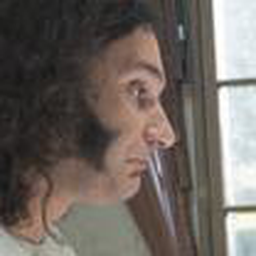

Saved saved new images


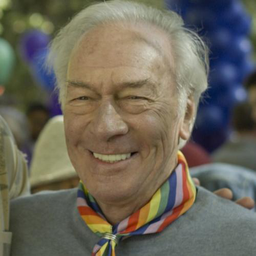

Saved saved new images


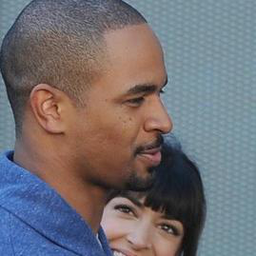

Processed 76500
Saved saved new images


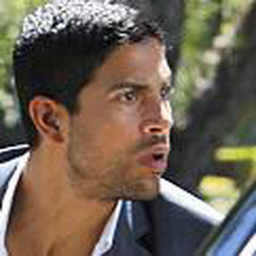

Saved saved new images


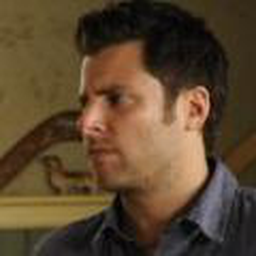

Processed 77000
Saved saved new images


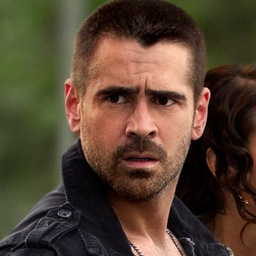

Saved saved new images


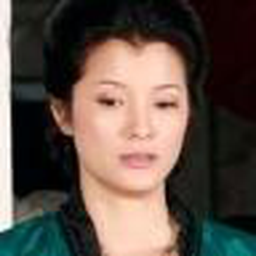

Saved saved new images


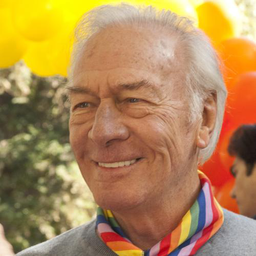

Processed 77500
Saved saved new images


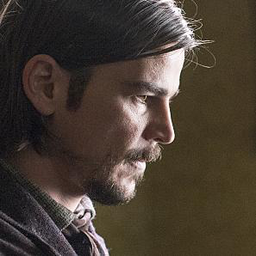

Saved saved new images


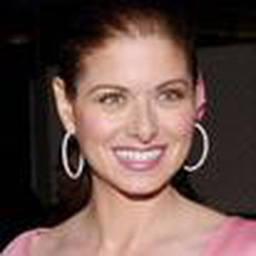

Processed 78000
Saved saved new images


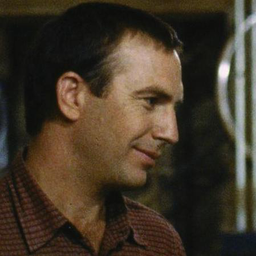

Saved saved new images


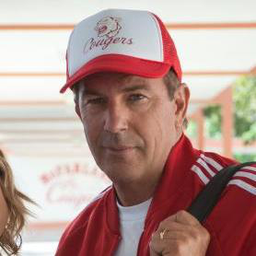

Saved saved new images


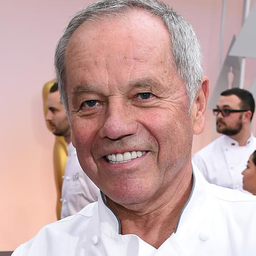

Processed 78500
Saved saved new images


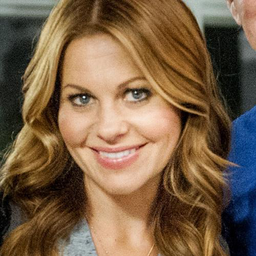

Saved saved new images


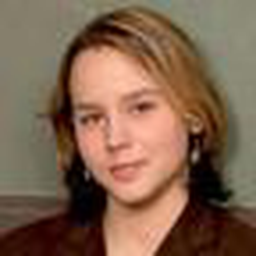

Processed 79000
Saved saved new images


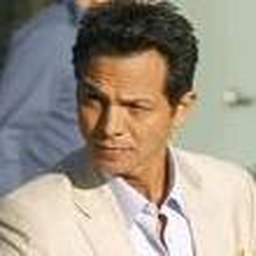

Saved saved new images


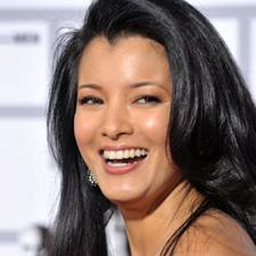

Saved saved new images


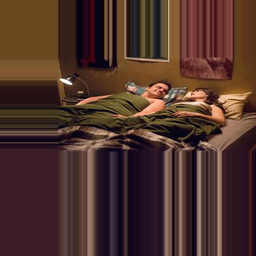

Processed 79500
Saved saved new images


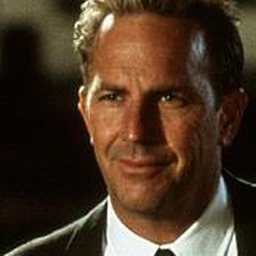

Saved saved new images


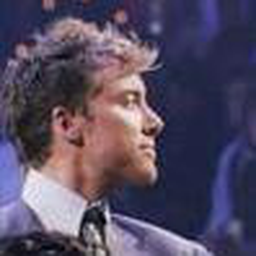

Processed 80000
Saved saved new images


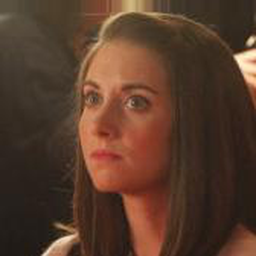

Saved saved new images


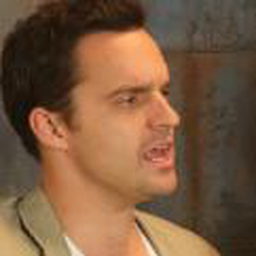

Saved saved new images


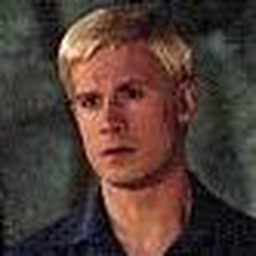

Processed 80500
Saved saved new images


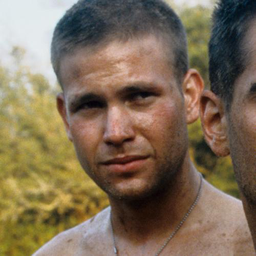

Saved saved new images


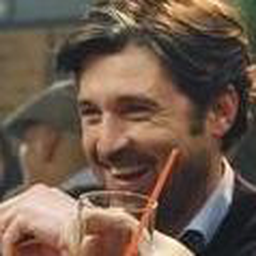

Processed 81000
Saved saved new images


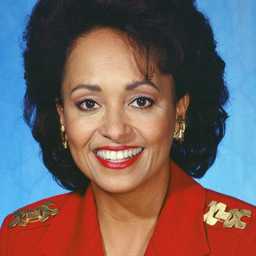

Saved saved new images


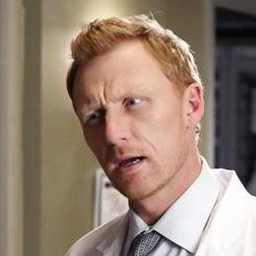

Saved saved new images


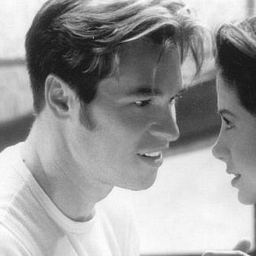

Processed 81500
Saved saved new images


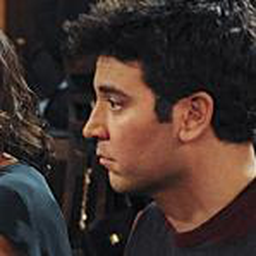

Saved saved new images


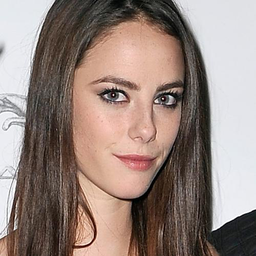

Processed 82000
Saved saved new images


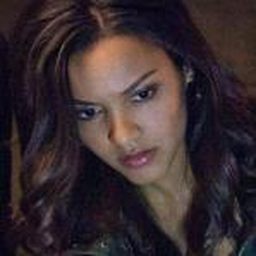

Saved saved new images


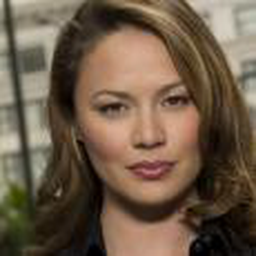

Saved saved new images


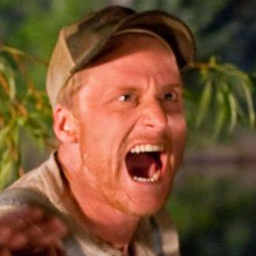

Processed 82500
Saved saved new images


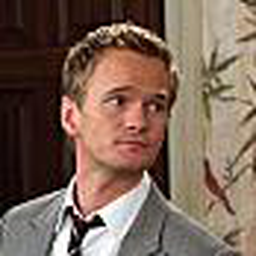

Saved saved new images


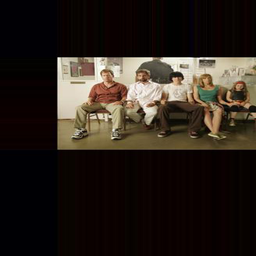

Processed 83000
Saved saved new images


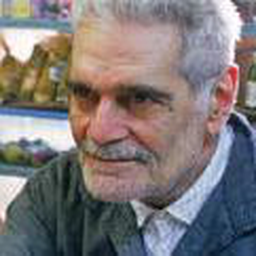

Saved saved new images


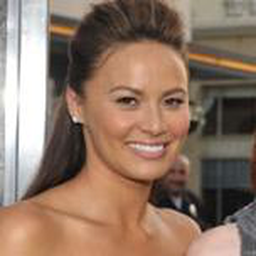

Saved saved new images


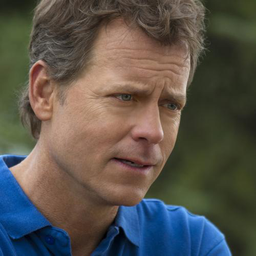

Processed 83500
Saved saved new images


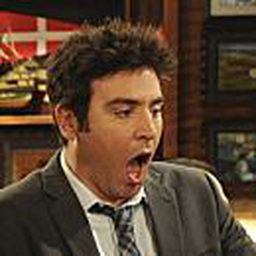

Saved saved new images


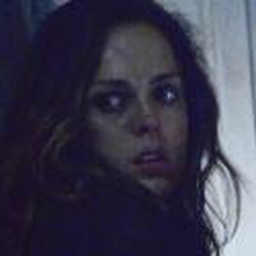

Processed 84000
Saved saved new images


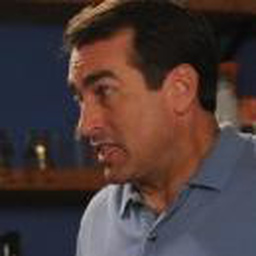

Saved saved new images


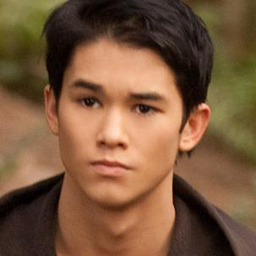

Saved saved new images


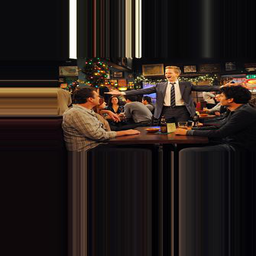

Processed 84500
Saved saved new images


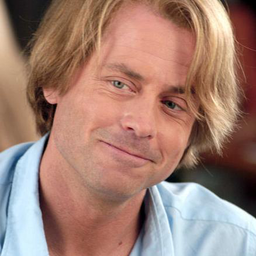

Saved saved new images


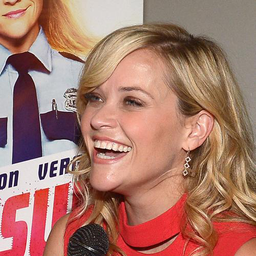

Processed 85000
Saved saved new images


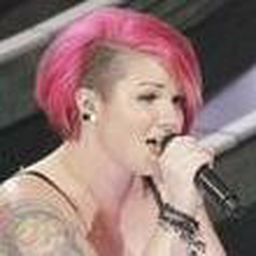

Saved saved new images


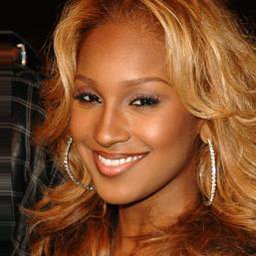

Saved saved new images


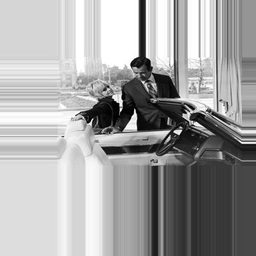

Processed 85500
Saved saved new images


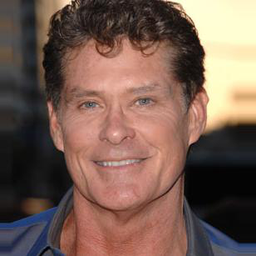

Saved saved new images


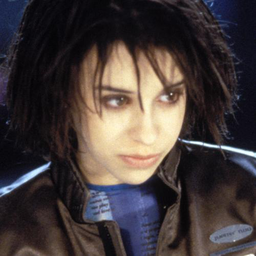

Processed 86000
Saved saved new images


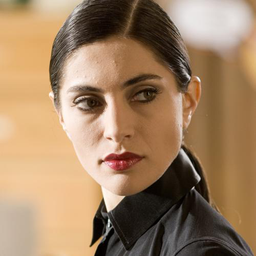

Saved saved new images


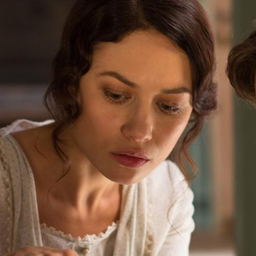

Saved saved new images


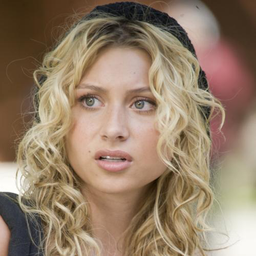

Processed 86500
Saved saved new images


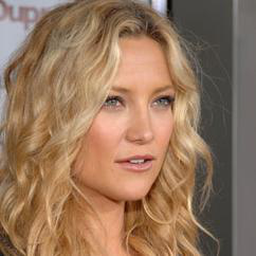

Saved saved new images


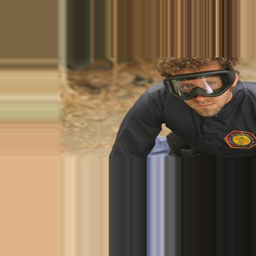

Processed 87000
Saved saved new images


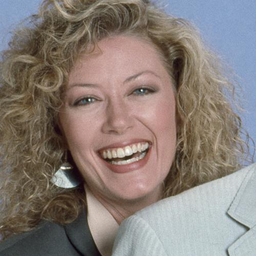

Saved saved new images


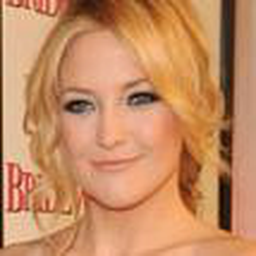

Saved saved new images


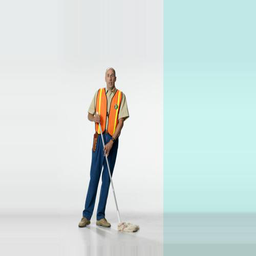

Processed 87500
Saved saved new images


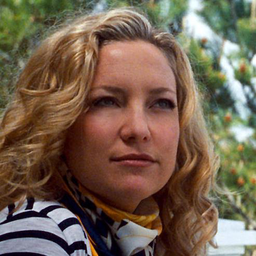

Saved saved new images


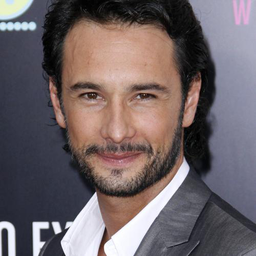

Processed 88000
Saved saved new images


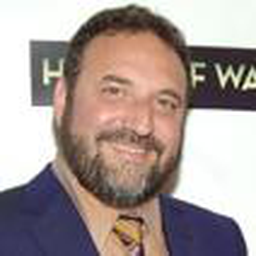

Saved saved new images


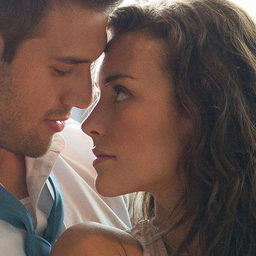

Saved saved new images


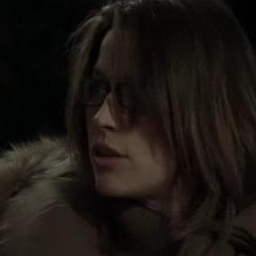

Processed 88500
Saved saved new images


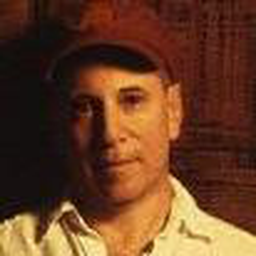

Saved saved new images


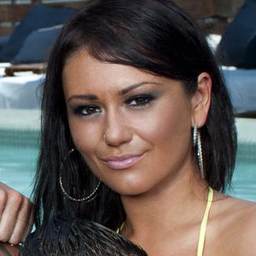

Processed 89000
Saved saved new images


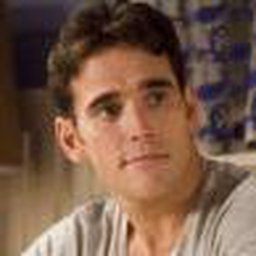

Saved saved new images


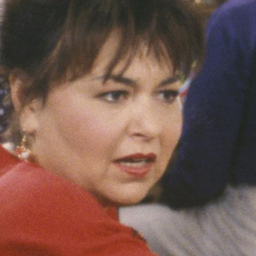

Saved saved new images


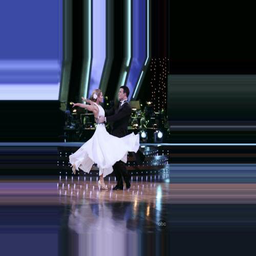

Processed 89500
Saved saved new images


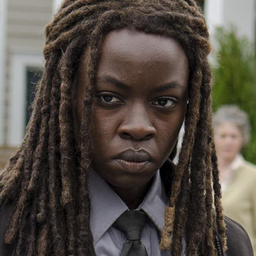

Saved saved new images


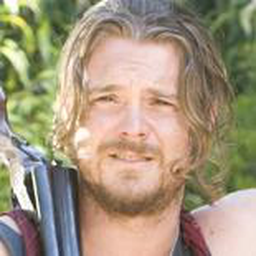

Processed 90000
Saved saved new images


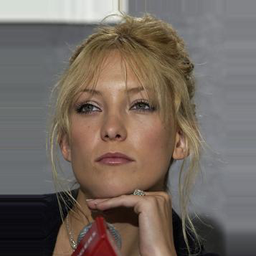

Saved saved new images


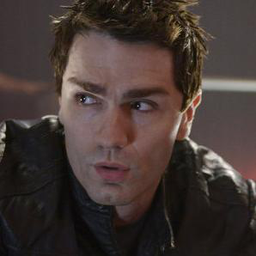

Saved saved new images


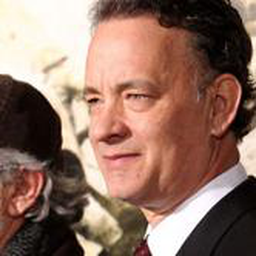

Processed 90500
Saved saved new images


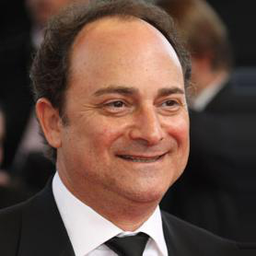

Saved saved new images


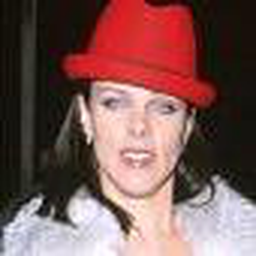

Processed 91000
Saved saved new images


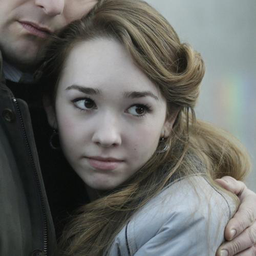

Saved saved new images


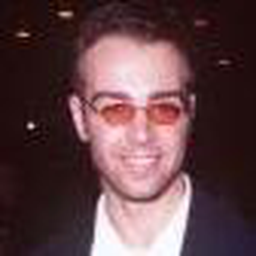

Saved saved new images


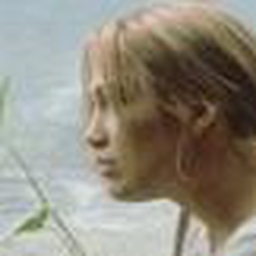

Processed 91500
Saved saved new images


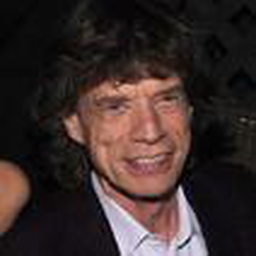

Saved saved new images


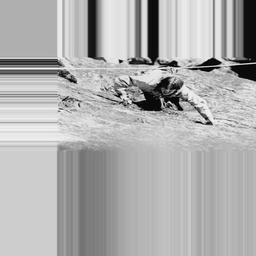

Processed 92000
Saved saved new images


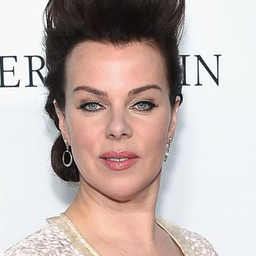

Saved saved new images


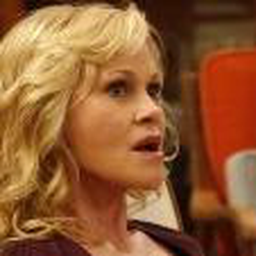

Saved saved new images


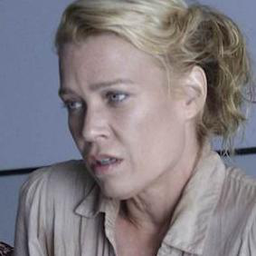

Processed 92500
Saved saved new images


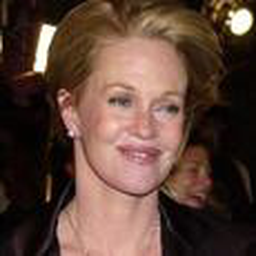

Saved saved new images


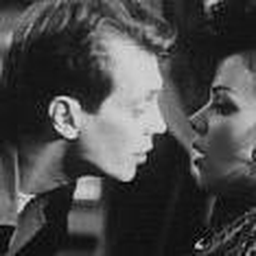

Processed 93000
Saved saved new images


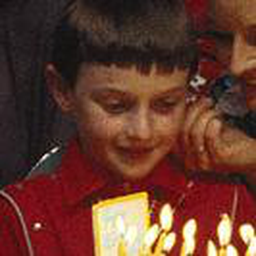

Saved saved new images


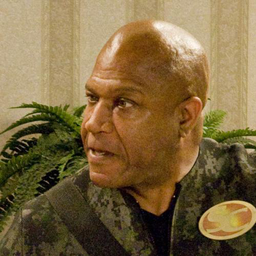

Saved saved new images


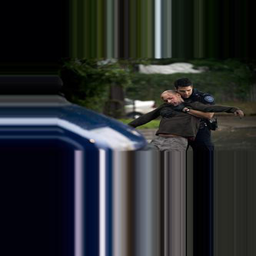

Processed 93500
Saved saved new images


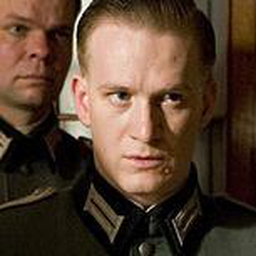

Saved saved new images


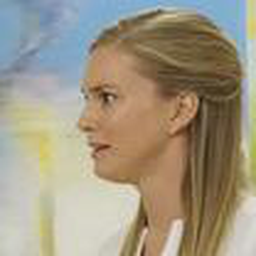

Processed 94000
Saved saved new images


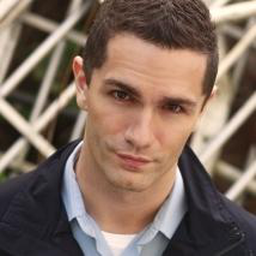

Saved saved new images


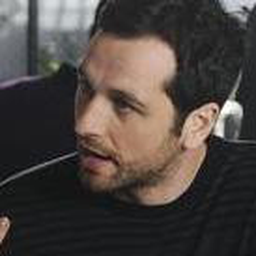

Saved saved new images


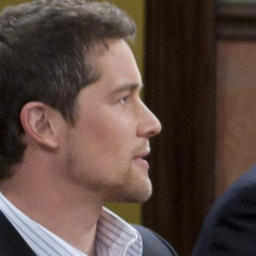

Processed 94500
Saved saved new images


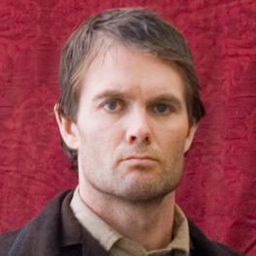

Saved saved new images


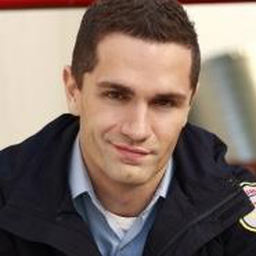

Processed 95000
Saved saved new images


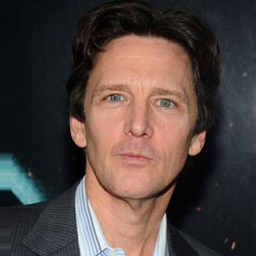

Saved saved new images


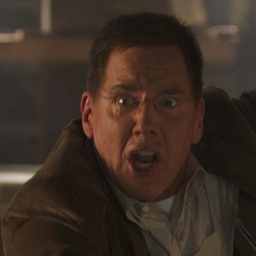

Saved saved new images
Buffered data was truncated after reaching the output size limit.

In [ ]:
import shutil
import os

NEW_FOLDER_PATH = '/content/IMDB_2'

processed = 0
batch = 1 
existing = 0
saved = 0

for i in range(100): 
  for (dirpath, dirnames, filenames) in walk ("/content/IMDB/imdb_crop/" + str(i)):
     for f in filenames:
      if f.endswith(".jpg"):
         processed += 1
         if((processed % 500) == 0): print(f"Processed {processed}")
         file_path = dirpath + "/" + f

         # Extract age
         age = get_age_IMDB(f) 
         
         # Check if image is already saved
         if os.path.isfile(NEW_FOLDER_PATH + "/batch-"+ str(batch) + "/" + f):
           existing += 1 
           if((existing % 500) == 0): print(f"Found {existing} already existing")
           continue 
         im = Image.open(file_path)
         im = im.resize((256,256), Image.ANTIALIAS)
         
         save_image(NEW_FOLDER_PATH + "/batch-"+ str(batch) + "/", str(age) + "_" + f, im) 
         saved +=1
         if saved % 200 == 0: 
           print("Saved saved new images")
           display(im)
  if (i % 10 == 0):
    backup_to_bucket(NEW_FOLDER_PATH + "/batch-" + str(batch), "gs://ntnu-ml-bucket/IMDB/batches/batch-" + str(batch) )
    batch += 1


# 4. Save the preprocessed IMDB images to Google Cloud Platform

In [ ]:
_("/content/IMDB_images", "gs://ntnu-ml-bucket/IMDB/IMDB_by_age_group.zip")

COMPRESSING (1/2)    from    /content/IMDB_images    to    /tmp_/IMDB_by_age_group.zip
UPLOADING FILE (2/2)    from    /tmp_/IMDB_by_age_group.zip    to    gs://ntnu-ml-bucket/IMDB/IMDB_by_age_group.zip
